In [1]:
import copy
import socket
import os
import pickle 
# import ssm #need to/ keep 
import sys
import glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap


sys.path.append("/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/")
sys.path.append('/Users/bennetsakelaris/Documents/Obsidian Vault/Worms/wormcode/Code+Notes 09-24-24/collab/')

from scipy.ndimage import gaussian_filter1d
from get_data.read_neuro_beh_data import get_exp_features, load_json
from get_data.process_neural_data import get_derivative_of_neural_activity, get_neural_activity_from_labels, get_neural_activity_and_labels
from beh_classification.behavior_features import get_behavior_features
from beh_classification.get_behavior_classifications import get_behavior_classification
# from beh_classification.beh_classification_utils import get_start_end_is_of_ones_in_binary_array
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import balanced_accuracy_score

from sklearn import svm
from sklearn.svm import LinearSVC
from sklearn.neighbors import NearestNeighbors

from load_data_fncs import load_all_data, get_exp_dates
from analyse_rslds_utils import make_behavior_decoder, input_slds

In [2]:

from matplotlib.colors import LinearSegmentedColormap

#color palette for plotting, colors as in make_behavior_ethogram
palette = ["coral",     # forward
           "lightblue", # reverse
           "darkgreen", # turn
           "purple","red", "yellow", "black", "pink"]    # pause
cmap = LinearSegmentedColormap.from_list("behavior", palette, N=len(palette))


# Load data, model, behavior decoder

In [3]:


T = 1599
full_traces, full_neural_labels, full_beh_classification, full_beh_data = load_all_data()

velocity_og = np.array([full_beh_data[i]["velocity"][0:1599] for i in range(len(full_beh_data))])
acceleration_og = np.array([full_beh_data[i]["acceleration"][1:1600] for i in range(len(full_beh_data))])
head_curvature_og = np.array([full_beh_data[i]["head_angle"][0:1599] for i in range(len(full_beh_data))])
worm_curvature_og = np.array([full_beh_data[i]["worm_curvature"][0:1599] for i in range(len(full_beh_data))])
pumping_og = np.array([full_beh_data[i]["pumping"][0:1599] for i in range(len(full_beh_data))])
body_angle_mag_og = np.array([full_beh_data[i]["body_angle_mag"][0:1599] for i in range(len(full_beh_data))])
midlines_og =  np.array([full_beh_data[i]["midlines"][0:1599] for i in range(len(full_beh_data))])
body_angles_og =  np.array([full_beh_data[i]["body_angles"][0:1599] for i in range(len(full_beh_data))])

velocity = copy.deepcopy(velocity_og)
acceleration = copy.deepcopy(acceleration_og)
head_curvature = copy.deepcopy(head_curvature_og)
worm_curvature = copy.deepcopy(worm_curvature_og)
pumping = copy.deepcopy(pumping_og)
body_angle_mag =copy.deepcopy(body_angle_mag_og)
midlines =copy.deepcopy( midlines_og)
body_angles = copy.deepcopy(body_angles_og)


np.random.seed(0)

foldername = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/test_rslds_QM_run_061325/model_selection/top_2_combined/"
items = np.array(os.listdir(foldername))
folders = np.array(["." not in directory for directory in items], dtype=bool)
folders = items[folders]

folder = folders[0]

with open(foldername+"/Y.npy", 'rb') as handle:  
    Y = pickle.load(handle)


with open(foldername+folder+"/saved_data/prior.npy", 'rb') as handle:
    global_worm = pickle.load(handle)
    global_worm.D = int(global_worm.D)

with open(foldername+folder+"/saved_data/prior_q.npy", 'rb') as handle:
    q = pickle.load(handle)
    

slds = global_worm

neural_labels = np.load(foldername+"/neurons.npy", allow_pickle=True)

# set up a single behavioral state array ("z" in the language of scott): 
z = [beh_classification["is_fwd"][0:1599]+ 2*beh_classification["is_rev"][0:1599]+ 4*beh_classification["is_pause"][0:1599]+3*beh_classification["is_turn"][0:1599]-1 for beh_classification in full_beh_classification]

# get estimated latents, states
q_x = q.mean_continuous_states
q_z = [slds.most_likely_states(q_x[w], Y[w]) for w in range(len(q_x))]

# traces, neural_labels, behavior_classification, mask = load_all_data_but_pretend_its_all_one_worm()

# velocity = np.array([full_beh_data[i]["velocity"][0:1599] for i in range(len(full_beh_data))])
# # velocity_all = 
# acceleration = np.array([full_beh_data[i]["acceleration"][1:1600] for i in range(len(full_beh_data))])
# head_curvature = np.array([full_beh_data[i]["head_angle"][0:1599] for i in range(len(full_beh_data))])
# worm_curvature = np.array([full_beh_data[i]["worm_curvature"][0:1599] for i in range(len(full_beh_data))])
# pumping = np.array([full_beh_data[i]["pumping"][0:1599] for i in range(len(full_beh_data))])

q_z_all = np.concatenate(q_z)
z_all = np.concatenate(z)

# Input rSLDS
input_list = ["AVA", "RIB", "RIM", "AIB"]
new_slds, input_dict = input_slds(slds,neural_labels, input_list, input_list)
new_slds.D = int(new_slds.D)
input_dict

beh_decoder = make_behavior_decoder(q_x, z)



Worm 0, date: 2022-06-14-01
Worm 1, date: 2023-01-23-08
Worm 2, date: 2022-06-28-07
Worm 3, date: 2022-07-15-12
Worm 4, date: 2023-01-19-01
Worm 5, date: 2022-08-02-01
Worm 6, date: 2022-06-14-07
Worm 7, date: 2022-06-28-01
Worm 8, date: 2023-01-23-15
Worm 9, date: 2022-07-26-01
Worm 10, date: 2023-01-19-15
Worm 11, date: 2023-03-07-01
Worm 12, date: 2022-06-14-13
Worm 13, date: 2023-01-23-21
Worm 14, date: 2023-01-19-22
Worm 15, date: 2023-01-23-01
Worm 16, date: 2023-01-17-01
Worm 17, date: 2022-07-20-01
Worm 18, date: 2023-01-09-28
Worm 19, date: 2023-01-19-08
Worm 20, date: 2022-07-15-06


/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/beh_classification/behavior_features.py:11: RuntimeWarning: Mean of empty slice
  body_angles = body_angles-np.nanmean(body_angles, axis = 1)[:, None]
/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/beh_classification/behavior_features.py:15: RuntimeWarning: Mean of empty slice
  centroids = np.nanmean(midlines, axis = 1)


In [4]:

from rslds_visualization_utils import plot_states_and_neurons
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from compute_donut_utils import fix_signs, compute_phase,compute_radius, extract_rotation_angle, set_seed

import sys 

sys.path.append("/Users/friederikebuck/")
sys.path.append("/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/")
sys.path.append('/Users/bennetsakelaris/Documents/Obsidian Vault/Worms/wormcode/Code+Notes 09-24-24/collab/')
sys.path.append("/Users/friederikebuck/Downloads/worm notes/worm_code/fit_hierarchical/")

emissions_dim = max(traces.shape[1] for traces in full_traces)
model = slds

exp_dates = get_exp_dates() 




y = np.array(q_x)
pca = PCA(n_components=9, svd_solver="full")
pca.fit(np.concatenate(q_x[:-2])) #leave out two worms to test generalization
pca.components_ = fix_signs(pca.components_)
pca_x = pca.transform(np.concatenate(q_x))

#instead of training on phase, we'll train on sin and cosine to avoid the jumping between 2pi and 0
thetas = np.array([compute_phase(q_x[i], pca) for i in range(21)])
y_sin = [np.sin(y_i) for y_i in thetas]
y_cos = [np.cos(y_i) for y_i in thetas]

y = np.zeros((21, 1599, 3))
y[:,:,0] = y_sin
y[:,:,1] = y_cos
y[:,:,2] = [compute_radius(q_x[i], pca) for i in range(21)]

rotated_data = extract_rotation_angle(pca_x, n_neighbors=5)

rotated_data2d = rotated_data[:, 1:3]  # Project onto the principal plane
angles = np.arctan2(rotated_data2d[:, 1], rotated_data2d[:, 0])  

n_worms, timepoints = [21, 1599]
# angles = np.radians((270-np.degrees(angles+ np.pi))%360-180)

angles = angles.reshape(n_worms, timepoints)
rotated_data2d = rotated_data2d.reshape(n_worms, timepoints, 2)

y_sin = np.sin(angles)
y_cos = np.cos(angles)
radii = np.sqrt(rotated_data2d[..., 0]**2 + rotated_data2d[..., 1]**2)

y = np.stack([y_sin, y_cos, radii], axis=-1)
y.shape
z_norm = np.array(z, np.float64)

### This block is the main new thing compared to angles.ipynb

In [5]:
velocity -= velocity.mean()
velocity /= velocity.std()
acceleration -= acceleration.mean()
acceleration /= acceleration.std()
worm_curvature -= worm_curvature.mean()
worm_curvature /= worm_curvature.std()
z_norm -= z_norm.mean()
z_norm /= z_norm.std()
z_flat = np.array(z).flatten()
from angle.preprocess import prepare_data, split_and_normalize
from angle.train import train_model
from angle.plot_funcs_1 import plot_prediction, plot_held_out_worm

set_seed(42)
normalize=False
T = 5
X_all, y_all = prepare_data([velocity, acceleration, worm_curvature, z_norm], y, T=T, holdout_idxs=[20])
X_train, X_test, y_train, y_test, input_stats = split_and_normalize(X_all, y_all, normalize=normalize) # test here is held-out timepoints of held-in worms

input_dim = X_train.shape[2]
output_dim = y_train.shape[1]

In [6]:
from spont_rev_prediction_fncs import prep_data_spont_rev_prob, predict_spont_revs_from_features, predict_spont_revs_from_features_single_feature
from predict_latency_prob_from_features_donut import prep_FB_inputs_select_features_only_no_onset, fit_eval_linearSVC, visualize_model_classification
from predict_latency_prob_from_features_donut import fit_eval_lasso, visualize_model_regression
from spont_rev_prediction_fncs import predict_spont_revs_from_features, predict_spont_revs_from_features_single_feature, prep_data_spont_rev_latency

feature_list = [velocity, acceleration, worm_curvature]
feature_labels = ["flav_vel", "flav_accel", "flav_curv"]
rev_bin = np.array([z_w ==1 for z_w in z])

# all_timesteps = range(1, 21, 5) #range(1, 15, 3)
# win_start = 1
# # win_end = 5
# for win_end in range(5, 16, 3): 
#     n_splits = 10
#     test_size = 0.3
#     fps = 1.6

#     score_label = "balanced accuracy"
#     model_fit_fnc = fit_eval_linearSVC
#     prep_data_fnc = prep_data_spont_rev_prob #vs prep_data_spont_rev_latency
#     title_label = "FLAVELL spont revs"
#     result_visualization_fnc = visualize_model_classification


#     best_models = predict_spont_revs_from_features(   feature_list, 
#                                         feature_labels, rev_bin,
#                                         fps, 
#                                         win_start, win_end,
#                                         model_fit_fnc, 
#                                         score_label,
#                                         result_visualization_fnc, 
#                                         prep_data_fnc, 
                                        
#                                         title_label = title_label, 
#                                         all_timesteps = all_timesteps, 
#                                         test_size = test_size, 
#                                         n_splits = n_splits,  
#                                         # n_train = n_train,
#                                         # n_test = n_test, 

#                                         single_feature = False, 
#                                         n_pre_start = 0 ) 

# feature_list = [velocity, acceleration, worm_curvature]
# feature_labels = ["flav_vel", "flav_accel", "flav_curv"]
# rev_bin = np.array([z_w ==1 for z_w in z])

# all_timesteps = range(1, 21, 5) #range(1, 15, 3)
# win_start = 1
# win_end = 5
# n_splits = 10
# test_size = 0.3
# fps = 1.6

# score_label = "balanced accuracy"
# model_fit_fnc = fit_eval_linearSVC
# prep_data_fnc = prep_data_spont_rev_prob #vs prep_data_spont_rev_latency
# title_label = "FLAVELL spont revs"
# result_visualization_fnc = visualize_model_classification


# feature_to_best_models = predict_spont_revs_from_features_single_feature(   feature_list, 
#                                      feature_labels, rev_bin,
#                                      fps, 
#                                      win_start, win_end,
#                                      model_fit_fnc, 
#                                      score_label,
#                                      result_visualization_fnc, 
#                                      prep_data_fnc, 
                                     
#                                      title_label = title_label, 
#                                      all_timesteps = all_timesteps, 
#                                     test_size = test_size, 
#                                     n_splits = n_splits,  
#                                     # n_train = n_train,
#                                     # n_test = n_test, 

#                                     single_feature = False, 
#                                     n_pre_start = 0 ) 





In [7]:

feature_list = [velocity, acceleration, worm_curvature]
feature_labels = ["flav_vel", "flav_accel", "flav_curv"]
rev_bin = np.array([z_w ==1 for z_w in z])

# all_timesteps = range(1, 21, 5) #range(1, 15, 3)
# win_start = 1
# # win_end = 5
# for win_end in range(5, 16, 3): 
#     n_splits = 10
#     test_size = 0.3
#     fps = 1.6
    
#     score_label = "r2 score "
#     prep_data_fnc = prep_data_spont_rev_latency
#     model_fit_fnc = fit_eval_lasso
#     result_visualization_fnc = visualize_model_regression
#     title_label = "FLAVELL spont revs"



#     best_models = predict_spont_revs_from_features(   feature_list, 
#                                         feature_labels, rev_bin,
#                                         fps, 
#                                         win_start, win_end,
#                                         model_fit_fnc, 
#                                         score_label,
#                                         result_visualization_fnc, 
#                                         prep_data_fnc, 
                                        
#                                         title_label = title_label, 
#                                         all_timesteps = all_timesteps, 
#                                         test_size = test_size, 
#                                         n_splits = n_splits,  
#                                         # n_train = n_train,
#                                         # n_test = n_test, 

#                                         single_feature = False, 
#                                         n_pre_start = 0 ) 




# feature_list = [velocity, acceleration, worm_curvature]
# feature_labels = ["flav_vel", "flav_accel", "flav_curv"]
# rev_bin = np.array([z_w ==1 for z_w in z])

# all_timesteps = range(1, 21, 5) #range(1, 15, 3)
# win_start = 1
# # win_end = 5
# for win_end in range(5, 16, 3): 
#     n_splits = 10
#     test_size = 0.3
#     fps = 1.6
    
#     score_label = "r2 score "
#     prep_data_fnc = prep_data_spont_rev_latency
#     model_fit_fnc = fit_eval_lasso
#     result_visualization_fnc = visualize_model_regression
#     title_label = "FLAVELL spont revs"



# feature_to_best_models = predict_spont_revs_from_features_single_feature(   feature_list, 
#                                      feature_labels, rev_bin,
#                                      fps, 
#                                      win_start, win_end,
#                                      model_fit_fnc, 
#                                      score_label,
#                                      result_visualization_fnc, 
#                                      prep_data_fnc, 
                                     
#                                      title_label = title_label, 
#                                      all_timesteps = all_timesteps, 
#                                     test_size = test_size, 
#                                     n_splits = n_splits,  
#                                     # n_train = n_train,
#                                     # n_test = n_test, 

#                                     single_feature = False, 
#                                     n_pre_start = 0 ) 


in load data
[]
NOT using body angle mag for curvature
in replace_outliers_exp
in plot data
in reformar data
flavell_velocity.shahpe (21, 1599)
plotted
exp_acc1 (450000,)
resamplsep_pos_neg_resampleing
exp_acc1.shape) (120000,)

resampled_pause (120000,)
resampling
matching cdfs
in plot data
bins [-3.14159265 -2.51327412 -1.88495559 -1.25663706 -0.62831853  0.
  0.62831853  1.25663706  1.88495559  2.51327412  3.14159265]


/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: *c* argument looks like a single nu

Number of bins: 10
Number of bins: 10
Number of bins: 10
Number of bins: 10
Number of bins: 10
[<Figure size 400x200 with 2 Axes>, <Figure size 1400x400 with 12 Axes>, <Figure size 1800x300 with 18 Axes>, <Figure size 1200x300 with 12 Axes>, <Figure size 1900x700 with 24 Axes>, <Figure size 1600x700 with 24 Axes>]


[<Figure size 400x200 with 2 Axes>,
 <Figure size 1400x400 with 12 Axes>,
 <Figure size 1800x300 with 18 Axes>,
 <Figure size 1200x300 with 12 Axes>,
 <Figure size 1900x700 with 24 Axes>,
 <Figure size 1600x700 with 24 Axes>]

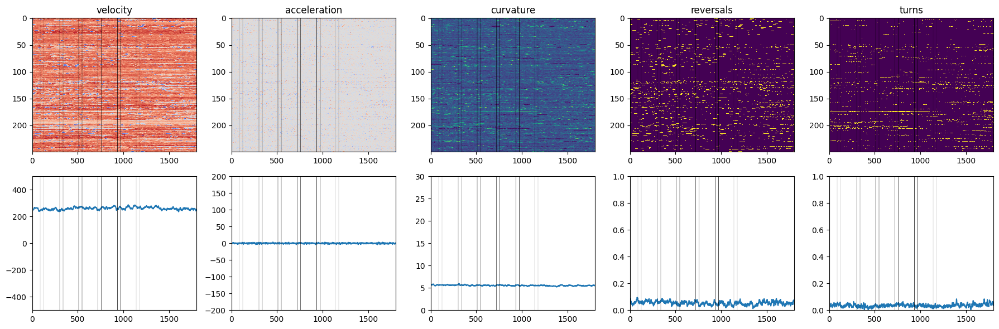

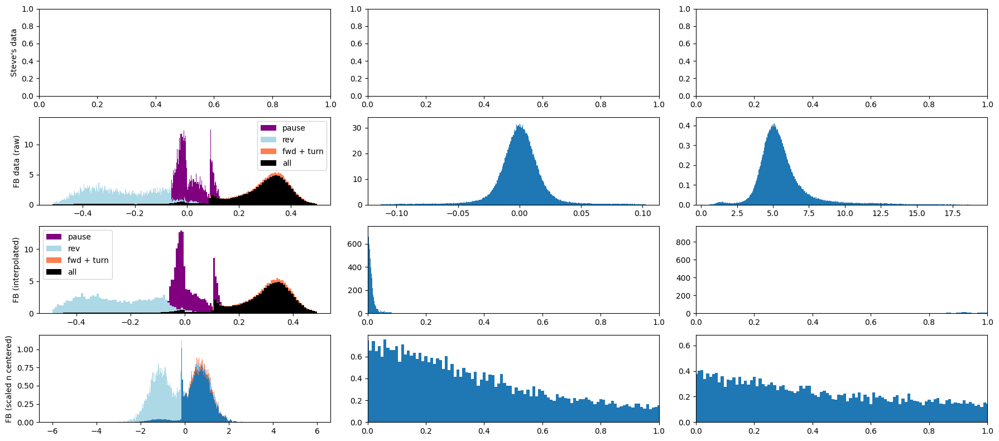

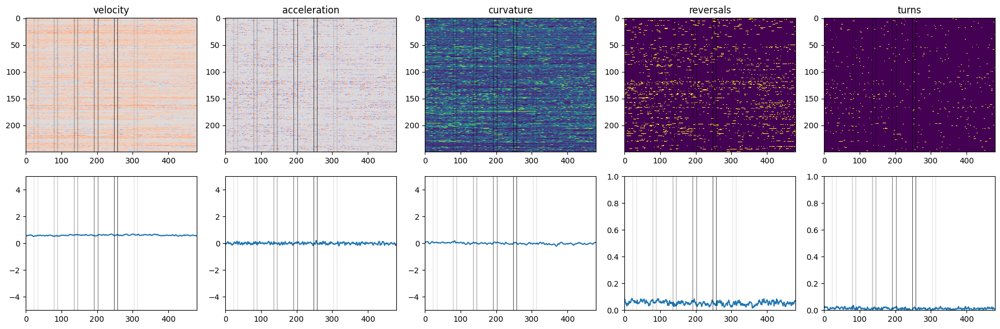

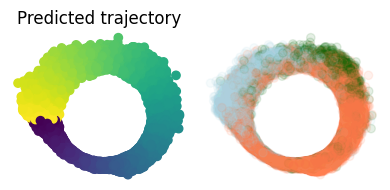

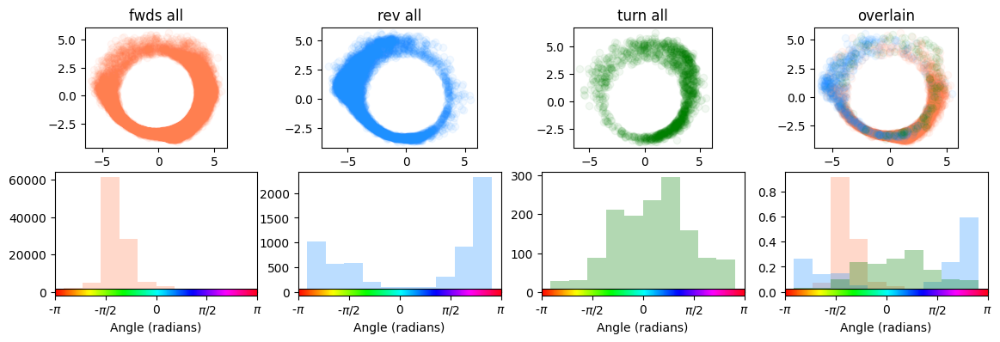

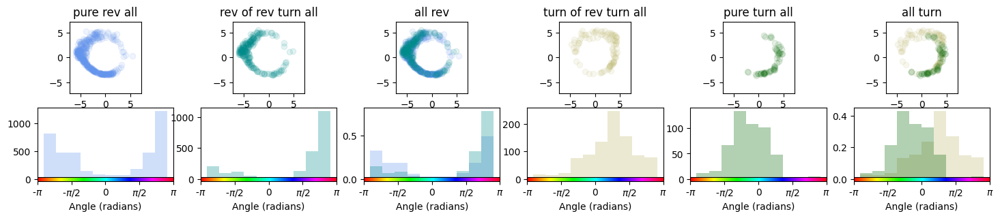

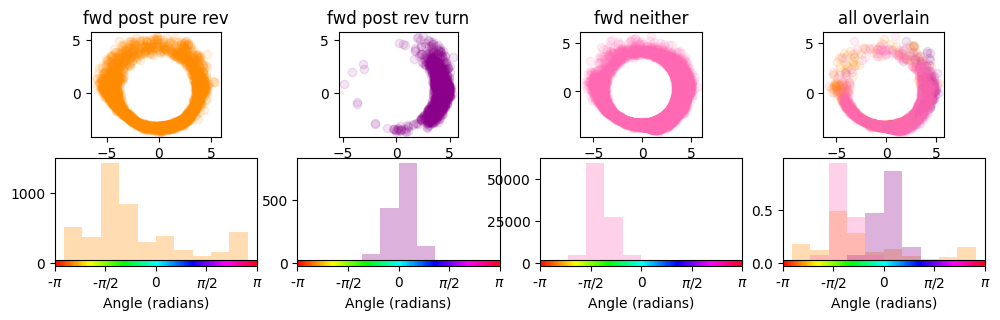

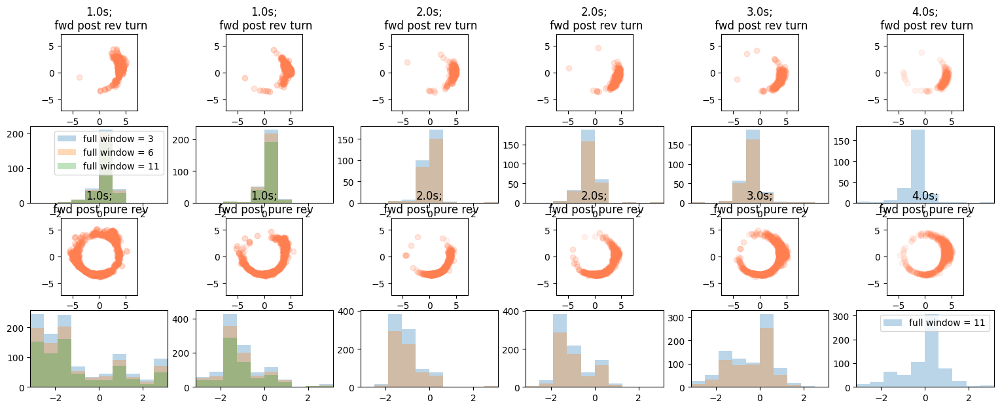

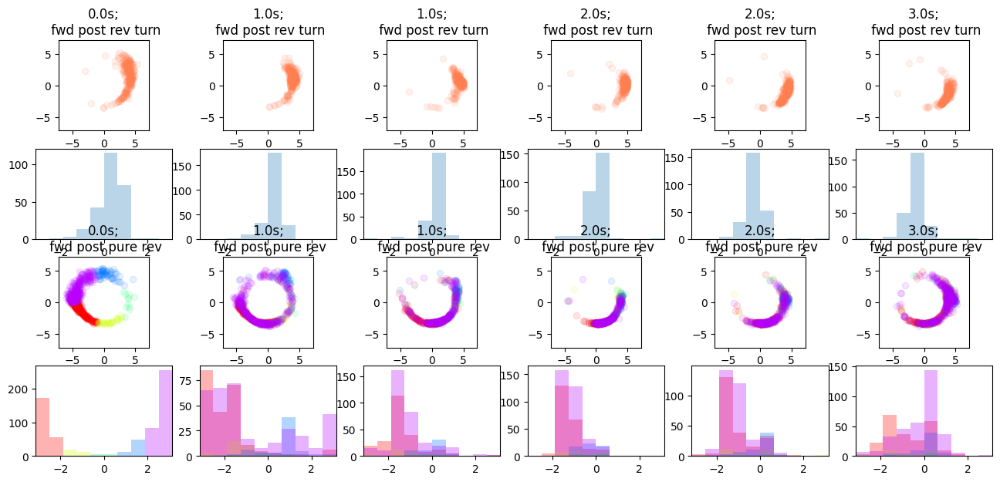

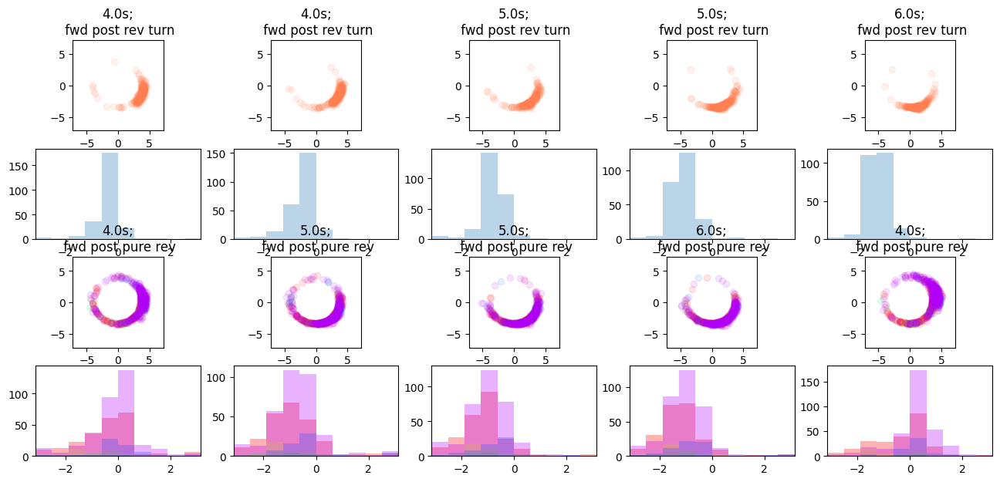

In [8]:
from visualize_donut_time_series_and_states import plot_donut_beh_figs_1
import pickle 
pickle_fname = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/worm_angles_concat_neural.pickle"
with open(pickle_fname, "rb") as handle:
    worm_angles_concat_neural, worm_radii_concat_neural, model_neural_directed = pickle.load(handle) 
    



pickle_fname = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/worm_angles_concat_beh.pickle"
with open(pickle_fname, "rb") as handle:
   worm_angles, worm_radii, model_beh_directed =  pickle.load( handle) 
    
    
from load_and_process_FB_data_fncs_8 import load_data, reformat_data,plot_data,  analyze_data, replace_outliers_exp, reformat_data_1
# experiment = "duty_cycle"
# condition = "control"
# neuron = "AVA"
# path = "/Users/friederikebuck/beh_analysis_results/csv/_Aim1_AVA_duty_cycle/"


# experiment = "duty_cycle"
# condition = "control"
# neuron = "AIB"
# path = "/Users/friederikebuck/beh_analysis_results/csv/_AIBC-3_Aim1_AIB_duty_cycle/"


experiment = "duty_cycle"
condition = "control"
neuron = "RIM"
path = "/Users/friederikebuck/beh_analysis_results/csv/_Aim1_RIM_duty_cycle/"

from load_and_process_FB_data_fncs_8 import  causal_moving_average,plot_data,   reformat_data_1, replace_outliers_exp, replace_outliers_neg_post_seperate_and_resample, smooth_trace,replace_outliers_and_resample,resample_binary,   match_cdf 


exp_data = load_data(experiment, condition, neuron, path = path)


spont_exp_vel, spont_exp_acc, spont_exp_curve, spont_exp_rev, spont_exp_pause, spont_exp_turn, stim_exp_body_angle_mag  = replace_outliers_exp(exp_data, exp_data[0].shape)

exp_onsets = plot_data(spont_exp_vel, spont_exp_acc, spont_exp_curve, spont_exp_rev, spont_exp_pause, experiment, fps=6)

spont_resampled_rev, spont_resampled_turn,spont_resampled_features,  spont_smooth_features, spont_matched_features = reformat_data_1(spont_exp_vel, 
                                                                                             spont_exp_acc,
                                                                                             spont_exp_curve,
                                                                                             spont_exp_rev,
                                                                                             spont_exp_turn, 
                                                                                             spont_exp_pause,
                                                                                             z_flat,
                                                                                             velocity, 
                                                                                             acceleration, 
                                                                                             worm_curvature,
                                                                                             plot=True, 
                                                                                             replace_outliers = True, 
                                                                                             sep_pos_neg_resample = True, match_vel_only = True
                                                                                             )

resampled_vel, resampled_acc, resampled_curve = spont_resampled_features
smooth_vel, smooth_acc, smooth_curve = spont_smooth_features
matched_vel, matched_acc, matched_curve = spont_matched_features


onsets = plot_data(matched_vel, matched_acc, matched_curve, spont_resampled_rev, spont_resampled_turn, experiment, fps=1.6, orig = False)
resampled_onsets = onsets

inferred_phases, final_behaviors, final_behaviors_all, inferred_phases_all, inferred_rad_all, behaviors_all, inferred_rad, initial_behaviors, initial_cts_beh, X_all_LSTM = analyze_data(matched_vel,
                                                                                                                                                                                         matched_acc, 
                                                                                                                                                                                         matched_curve, 
                                                                                                                                                                                         spont_resampled_rev, 
                                                                                                                                                                                         spont_resampled_turn, 
                                                                                                                                                                                         onsets, 
                                                                                                                                                                                         model_beh_directed,  
                                                                                                                                                                                         z_norm,input_stats,  
                                                                                                                                                                                         z,   
                                                                                                                                                                                         lag=16, 
                                                                                                                                                                                         inclusion_thresh = 2, 
                                                                                                                                                                                         model_type="ff", 
                                                                                                                                                                                         remove_revs=False
                                                                                                                                                                                         
                                                                                                                                                                                         )
beh_all_org = (behaviors_all*  np.array(z).std())+ np.array(z).mean()

plot_donut_beh_figs_1(inferred_phases_all,inferred_rad_all,  beh_all_org,

                         cmap,
                            n_bins = 10, 
                         window = 5)


i, n_timesteps, win_end -1 1 5
Y_time_to_revs_flat all unqiuecounts 0.0 105599
Y_time_to_revs_flat all unqiuecounts 1.0 1725
Y_time_to_revs_flat all unqiuecounts 2.0 1621
Y_time_to_revs_flat all unqiuecounts 3.0 1518
Y_time_to_revs_flat all unqiuecounts 4.0 1427
Y_time_to_revs_flat all unqiuecounts 5.0 1362
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 0
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 1
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 2
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 3
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 4
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 5
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 6
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 7
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 8
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 9
i, n_timesteps, win_end -1 4 5
Y_time_to_revs_flat all unqiuecounts 0.0 104927
Y_time_to_revs_flat all unqiuecounts 1.0 1720
Y_time

/Users/friederikebuck/Downloads/worm notes/worm_code/spont_rev_prediction_fncs.py:404: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


Y_time_to_revs_flat all unqiuecounts 0.0 416800
Y_time_to_revs_flat all unqiuecounts 1.0 1751
Y_time_to_revs_flat all unqiuecounts 2.0 1749
Y_time_to_revs_flat all unqiuecounts 3.0 1748
Y_time_to_revs_flat all unqiuecounts 4.0 1711
Y_time_to_revs_flat all unqiuecounts 5.0 1670
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 0
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 1
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 2
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 3
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 4
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 5
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 6
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 7
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 8
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 9
i, n_timesteps, win_end -1 4 5
Y_time_to_revs_flat all unqiuecounts 0.0 416121
Y_time_to_revs_flat all unqiuecounts 1.0 1744
Y_time_to_revs_flat all unqiuecounts 

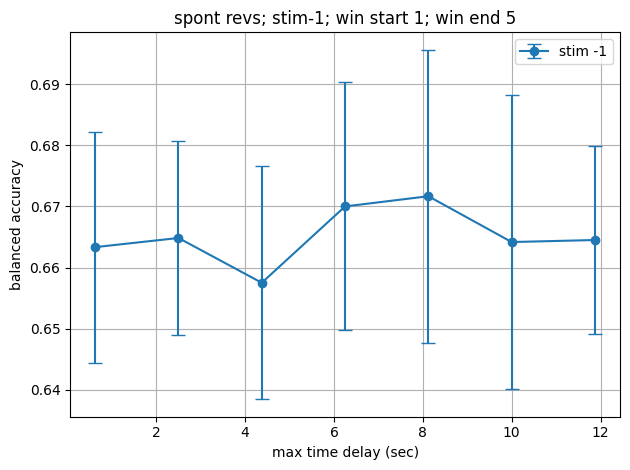

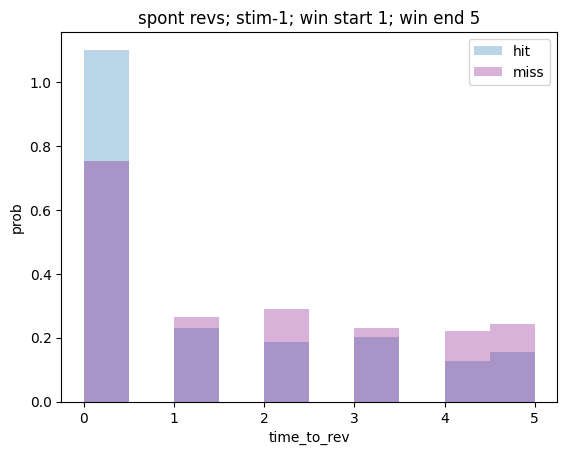

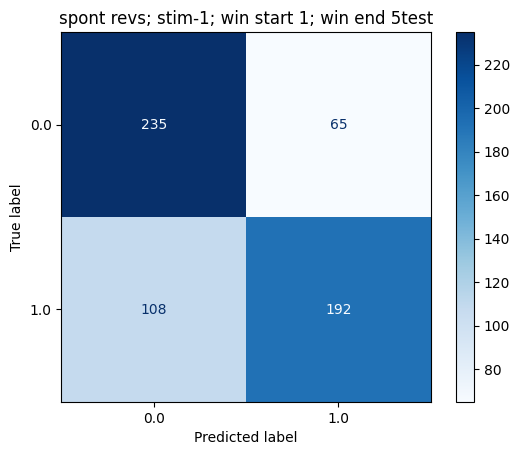

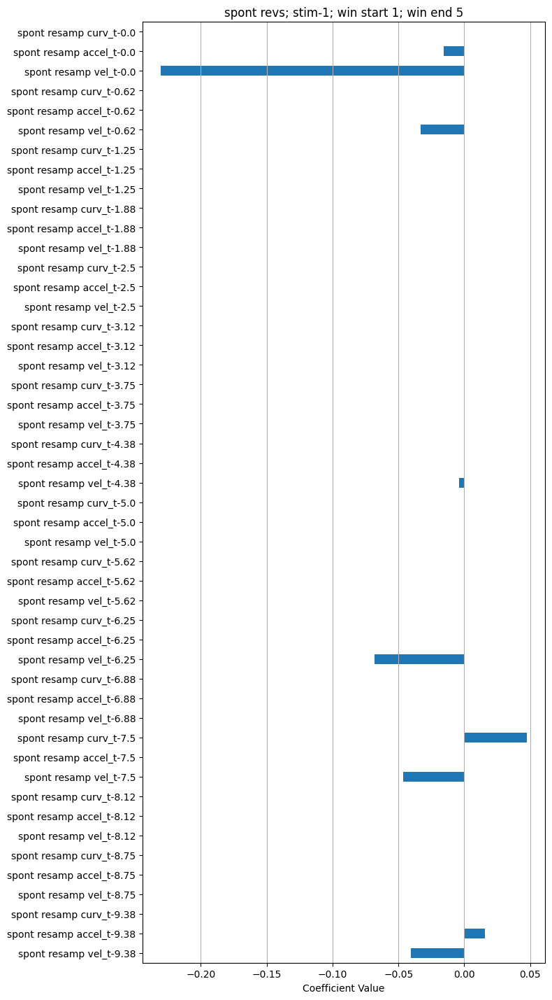

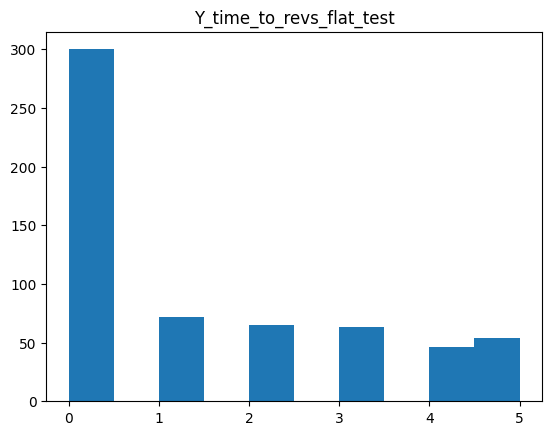

...

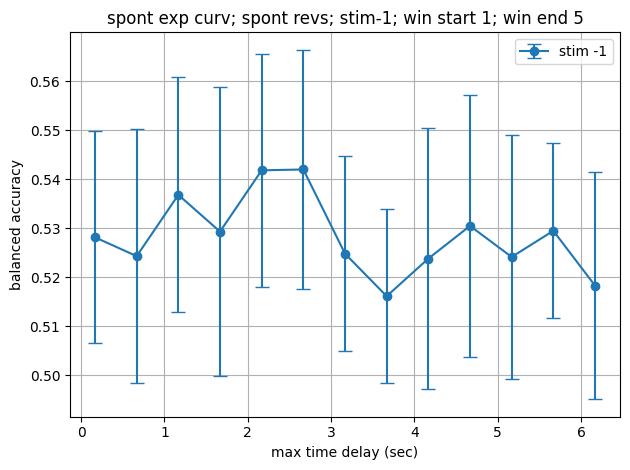

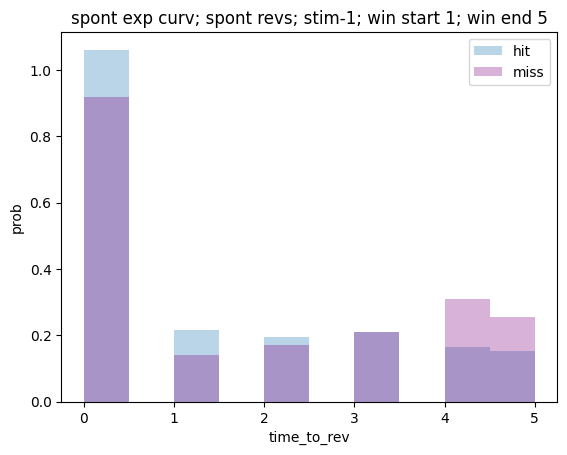

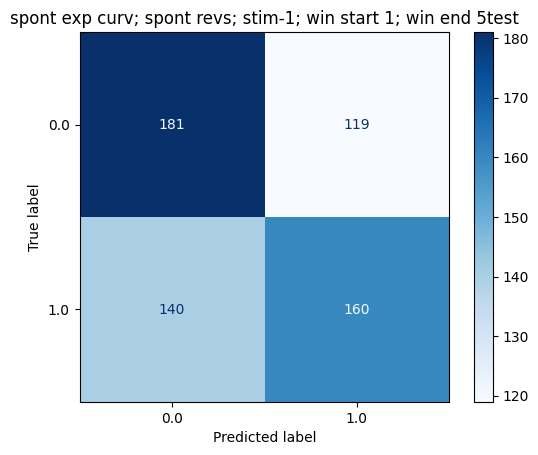

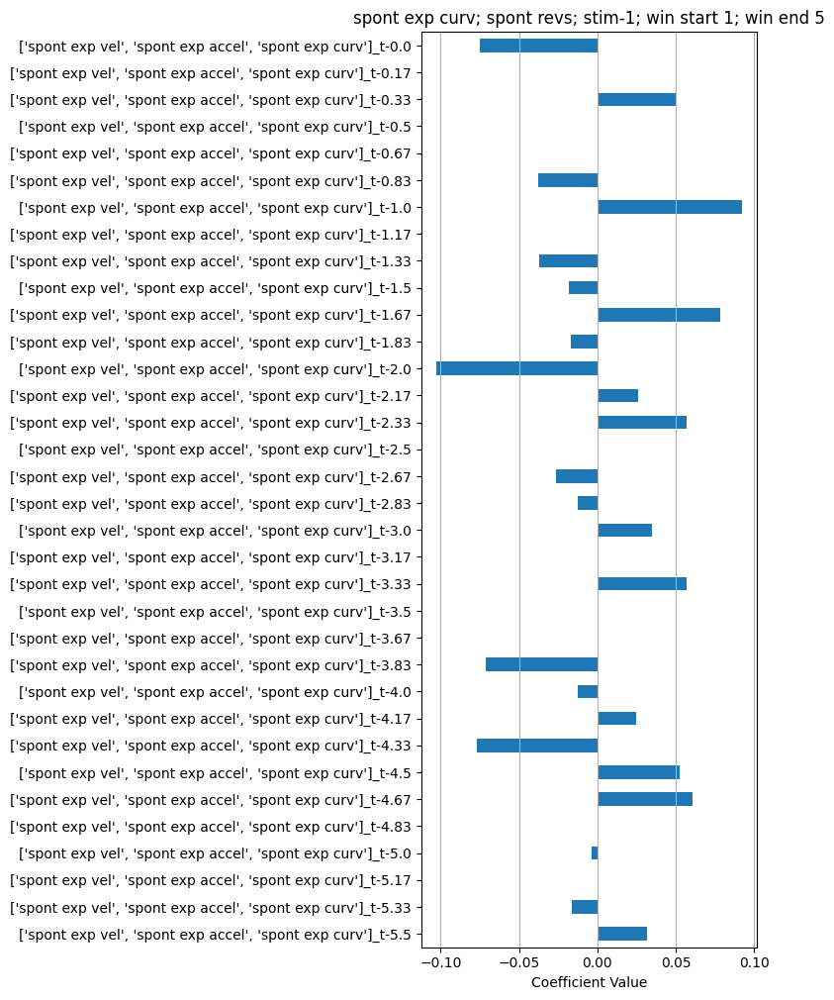

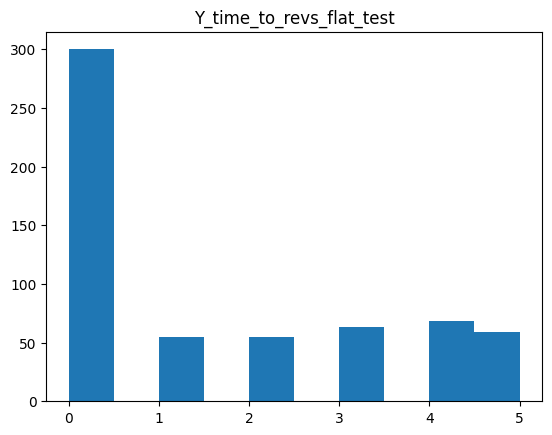

In [9]:

feature_list = spont_matched_features #[spont_resampled_vel, spont_resampled_acc, spont_resampled_curve]
feature_labels = ["spont resamp vel", "spont resamp accel", "spont resamp curv"]
rev_bin = spont_resampled_rev
fps = 1.6

# all_timesteps = range(1, 15, 5) #range(1, 15, 3)
resampled_timesteps = np.arange(1,20,3)
win_start = 1
win_end = 5
n_splits = 10
test_size = 0.3

score_label = "balanced accuracy"
model_fit_fnc = fit_eval_linearSVC
prep_data_fnc = prep_data_spont_rev_prob #vs prep_data_spont_rev_latency
title_label = "spont revs"
result_visualization_fnc = visualize_model_classification


best_models = predict_spont_revs_from_features(   feature_list, 
                                     feature_labels, rev_bin,
                                     fps, 
                                     win_start, win_end,
                                     model_fit_fnc, 
                                     score_label,
                                     result_visualization_fnc, 
                                     prep_data_fnc, 
                                     
                                     title_label = title_label, 
                                     all_timesteps = resampled_timesteps, 
                                    test_size = test_size, 
                                    n_splits = n_splits,  
                                    # n_train = n_train,
                                    # n_test = n_test, 

                                    single_feature = False, 
                                    n_pre_start = 0 ) 


feature_to_best_models = predict_spont_revs_from_features_single_feature(   feature_list, 
                                     feature_labels, rev_bin,
                                     fps, 
                                     win_start, win_end,
                                     model_fit_fnc, 
                                     score_label,
                                     result_visualization_fnc, 
                                     prep_data_fnc, 
                                     
                                     title_label = title_label, 
                                     all_timesteps = resampled_timesteps, 
                                    test_size = test_size, 
                                    n_splits = n_splits,  
                                    # n_train = n_train,
                                    # n_test = n_test, 

                                    single_feature = False, 
                                    n_pre_start = 0 ) 



##########
###########
###########

# all_timesteps = range(1, 25, 5) #range(1, 15, 3)
exp_timesteps = np.arange(1,40, 3)

feature_list = [spont_exp_vel, spont_exp_acc, spont_exp_curve]
feature_labels = ["spont exp vel", "spont exp accel", "spont exp curv"]
rev_bin =  spont_exp_rev


win_start = 1
win_end = 5
n_splits = 10
test_size = 0.3

fps = 6
score_label = "balanced accuracy"
model_fit_fnc = fit_eval_linearSVC
prep_data_fnc = prep_data_spont_rev_prob #vs prep_data_spont_rev_latency
title_label = "spont revs"
result_visualization_fnc = visualize_model_classification


best_models = predict_spont_revs_from_features(   feature_list, 
                                     feature_labels, rev_bin,
                                     fps, 
                                     win_start, win_end,
                                     model_fit_fnc, 
                                     score_label,
                                     result_visualization_fnc, 
                                     prep_data_fnc, 
                                     
                                     title_label = title_label, 
                                     all_timesteps = exp_timesteps, 
                                    test_size = test_size, 
                                    n_splits = n_splits,  
                                    # n_train = n_train,
                                    # n_test = n_test, 

                                    single_feature = False, 
                                    n_pre_start = 0 ) 


feature_to_best_models = predict_spont_revs_from_features_single_feature(   feature_list, 
                                     feature_labels, rev_bin,
                                     fps, 
                                     win_start, win_end,
                                     model_fit_fnc, 
                                     score_label,
                                     result_visualization_fnc, 
                                     prep_data_fnc, 
                                     
                                     title_label = title_label, 
                                     all_timesteps = exp_timesteps, 
                                    test_size = test_size, 
                                    n_splits = n_splits,  
                                    # n_train = n_train,
                                    # n_test = n_test, 

                                    single_feature = False, 
                                    n_pre_start = 0 ) 



            

i, n_timesteps, win_end -1 1 3
Y_time_to_revs_flat all unqiuecounts 0.0 108388
Y_time_to_revs_flat all unqiuecounts 1.0 1725
Y_time_to_revs_flat all unqiuecounts 2.0 1621
Y_time_to_revs_flat all unqiuecounts 3.0 1518
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 0
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 1
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 2
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 3
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 4
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 5
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 6
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 7
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 8
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 3 9
i, n_timesteps, win_end -1 4 3
Y_time_to_revs_flat all unqiuecounts 0.0 107702
Y_time_to_revs_flat all unqiuecounts 1.0 1720
Y_time_to_revs_flat all unqiuecounts 2.0 1619
Y_time_to_revs_flat all unqiuecounts 3.0 1514
Y_time

/Users/friederikebuck/Downloads/worm notes/worm_code/spont_rev_prediction_fncs.py:404: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


Y_time_to_revs_flat all unqiuecounts 0.0 98626
Y_time_to_revs_flat all unqiuecounts 1.0 1725
Y_time_to_revs_flat all unqiuecounts 2.0 1621
Y_time_to_revs_flat all unqiuecounts 3.0 1518
Y_time_to_revs_flat all unqiuecounts 4.0 1427
Y_time_to_revs_flat all unqiuecounts 5.0 1362
Y_time_to_revs_flat all unqiuecounts 6.0 1299
Y_time_to_revs_flat all unqiuecounts 7.0 1235
Y_time_to_revs_flat all unqiuecounts 8.0 1189
Y_time_to_revs_flat all unqiuecounts 9.0 1135
Y_time_to_revs_flat all unqiuecounts 10.0 1076
Y_time_to_revs_flat all unqiuecounts 11.0 1039
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 0
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 1
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 2
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 3
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 4
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 5
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 11 6
Y_time_to_revs_flat all unqiuecounts split_idx

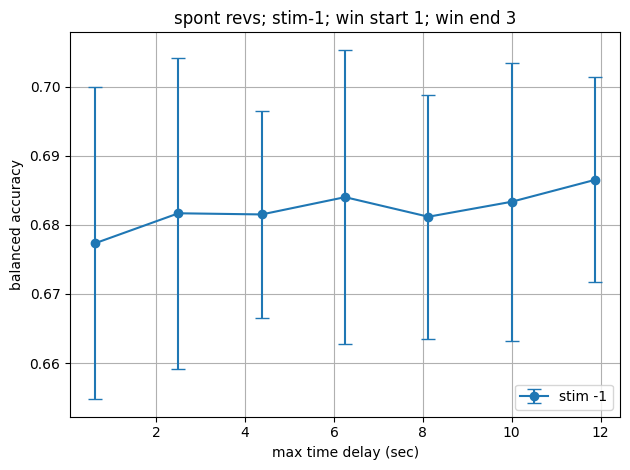

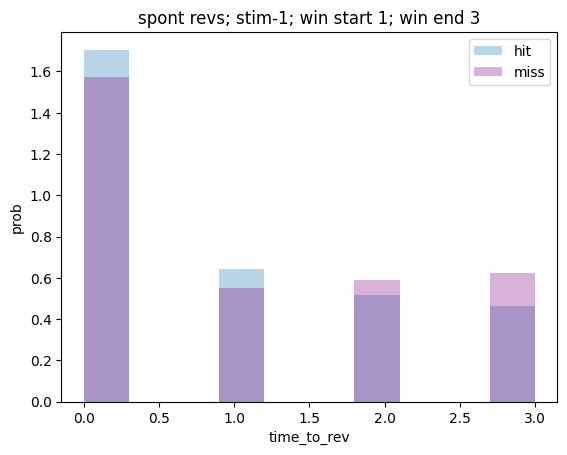

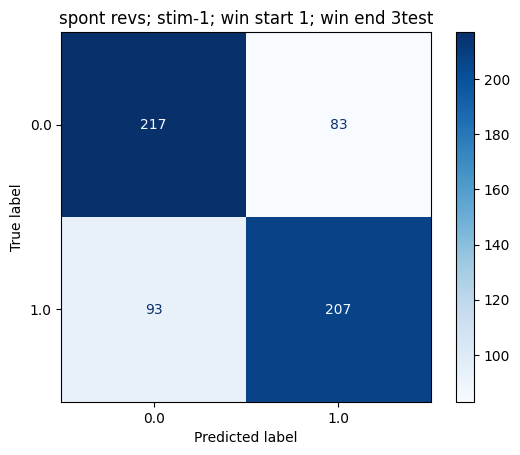

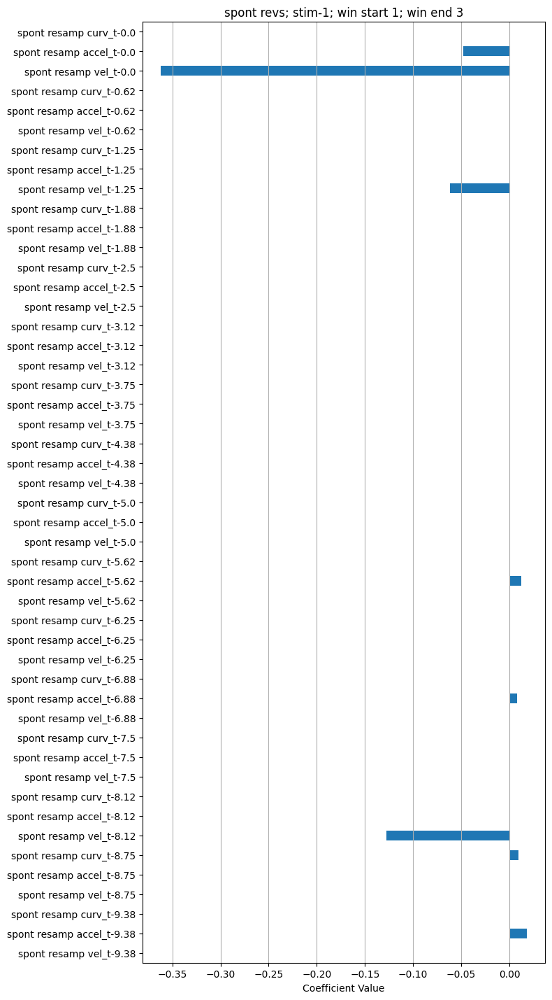

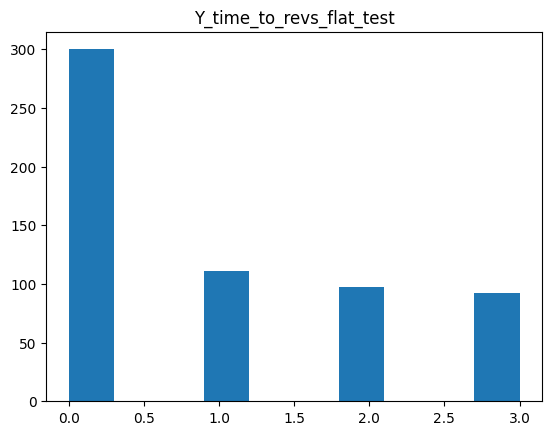

...

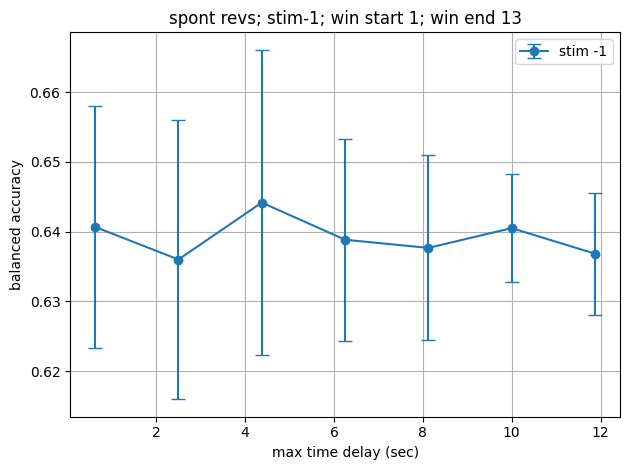

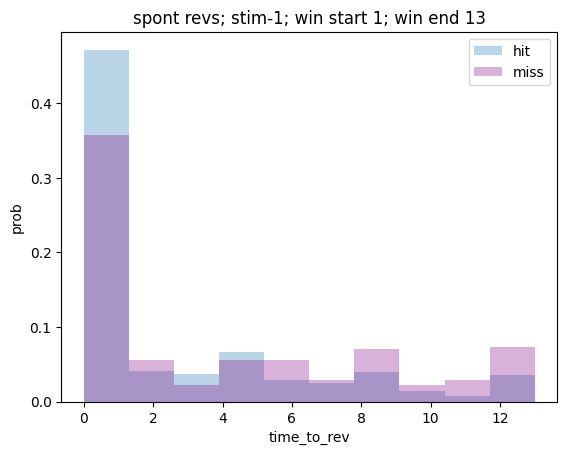

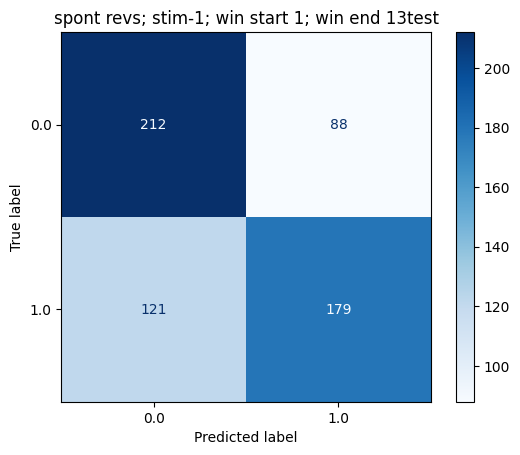

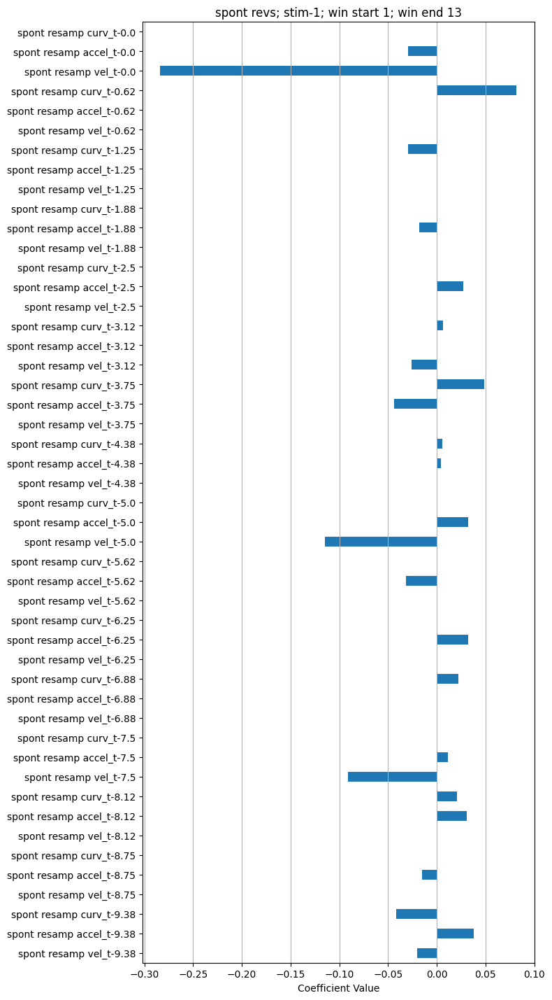

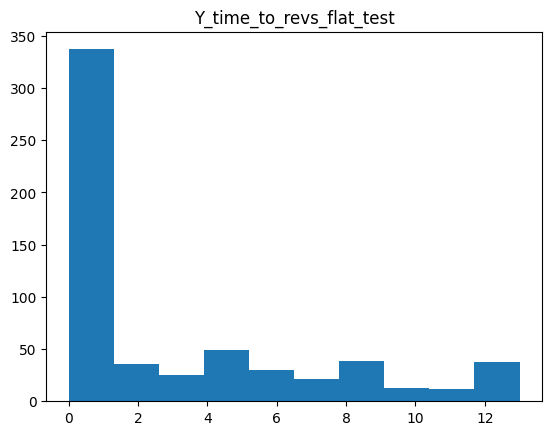

In [10]:

feature_list = spont_matched_features#[spont_resampled_vel, spont_resampled_acc, spont_resampled_curve]
feature_labels = ["spont resamp vel", "spont resamp accel", "spont resamp curv"]
rev_bin = spont_resampled_rev
fps = 1.6


win_start = 1
win_end = 5
n_splits = 10
test_size = 0.3

for win_end in range(3,15, 2):

    # win_start = 1
    # win_end = 5
    n_splits = 10
    test_size = 0.3
    n_train, n_test = 1000,300
    fps = 1.6
    score_label = "balanced accuracy"
    model_fit_fnc = fit_eval_linearSVC
    prep_data_fnc = prep_data_spont_rev_prob #vs prep_data_spont_rev_latency
    title_label = "spont revs"
    result_visualization_fnc = visualize_model_classification


    best_models = predict_spont_revs_from_features(   feature_list, 
                                        feature_labels, rev_bin,
                                        fps, 
                                        win_start, win_end,
                                        model_fit_fnc, 
                                        score_label,
                                        result_visualization_fnc, 
                                        prep_data_fnc, 
                                        
                                        title_label = title_label, 
                                        all_timesteps = resampled_timesteps, 
                                        test_size = test_size, 
                                        n_splits = n_splits,  
                                        # n_train = n_train,
                                        # n_test = n_test, 

                                        single_feature = False, 
                                        n_pre_start = 0 ) 


i, n_timesteps, win_end -1 1 5
CHECK TRUE!: True
Y_time_to_revs_flat all unqiuecounts 1.0 1725
Y_time_to_revs_flat all unqiuecounts 2.0 1621
Y_time_to_revs_flat all unqiuecounts 3.0 1518
Y_time_to_revs_flat all unqiuecounts 4.0 1427
Y_time_to_revs_flat all unqiuecounts 5.0 1362
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 0
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 1
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 2
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 3
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 4
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 5
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 6
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 7
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 8
Y_time_to_revs_flat all unqiuecounts split_idx -1 1 5 9
i, n_timesteps, win_end -1 6 5
CHECK TRUE!: True
Y_time_to_revs_flat all unqiuecounts 1.0 1717
Y_time_to_revs_flat all unqiuecounts 2.0 1614
Y_time_to_revs_flat 

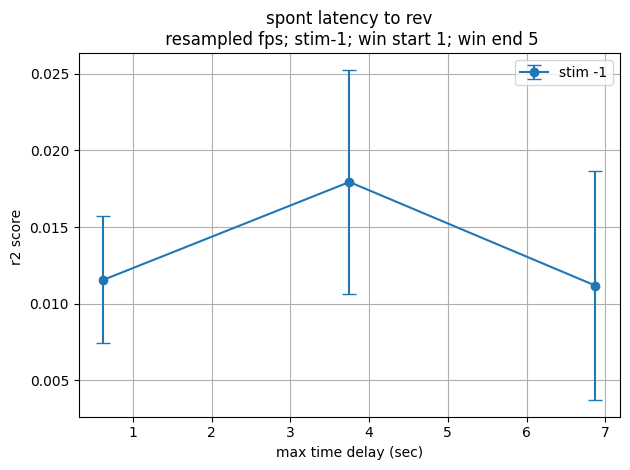

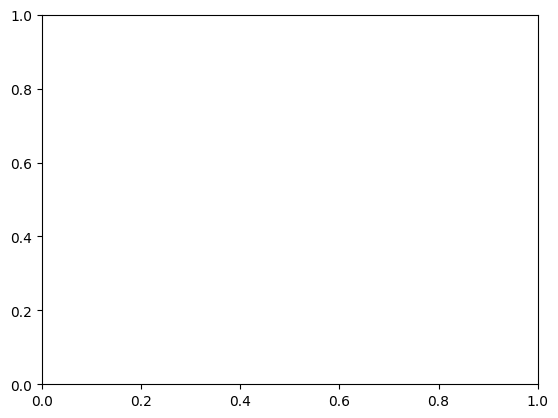

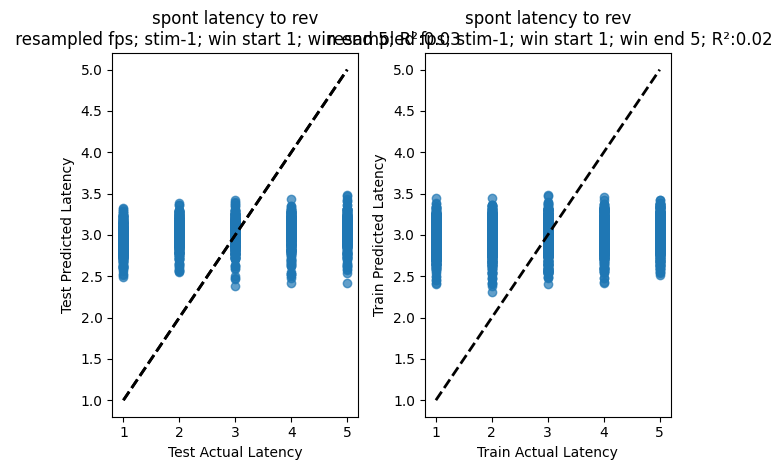

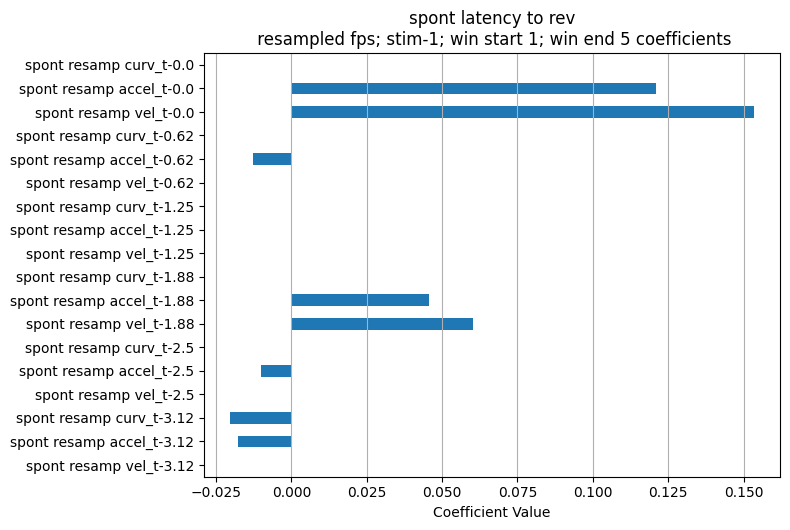

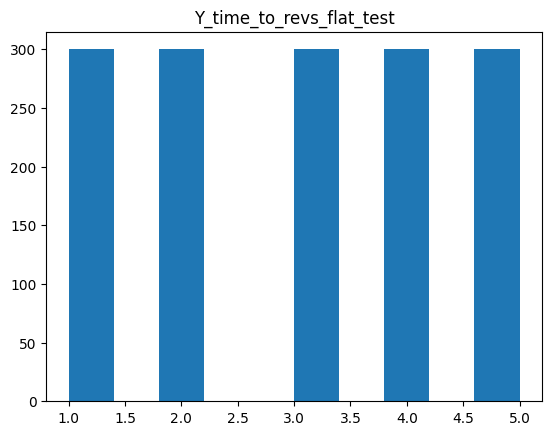

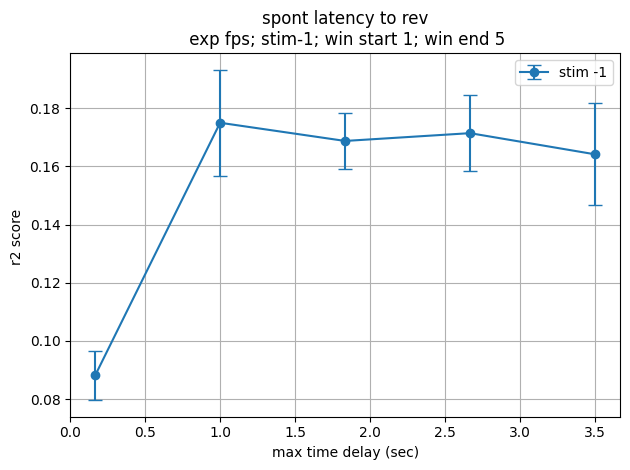

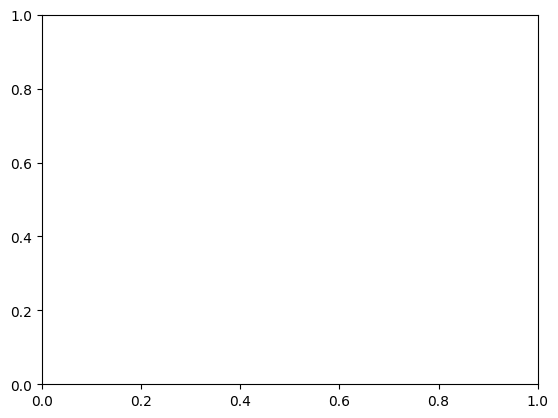

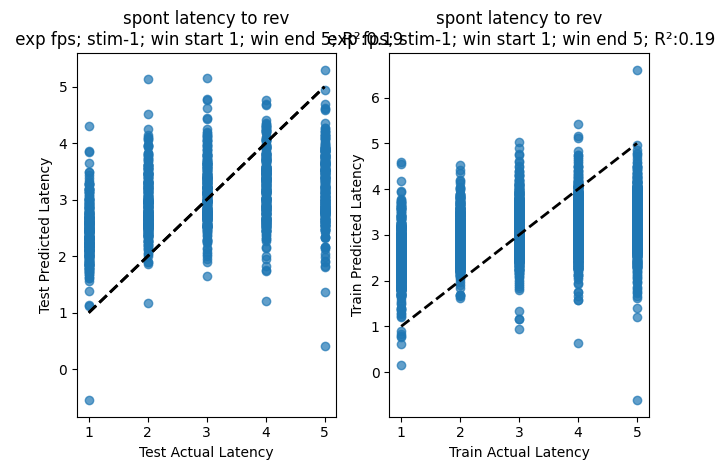

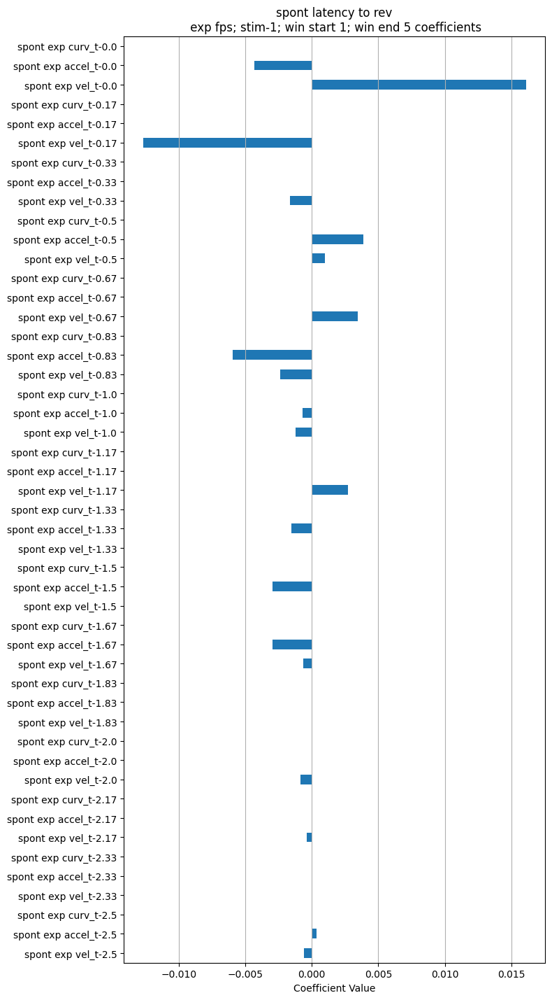

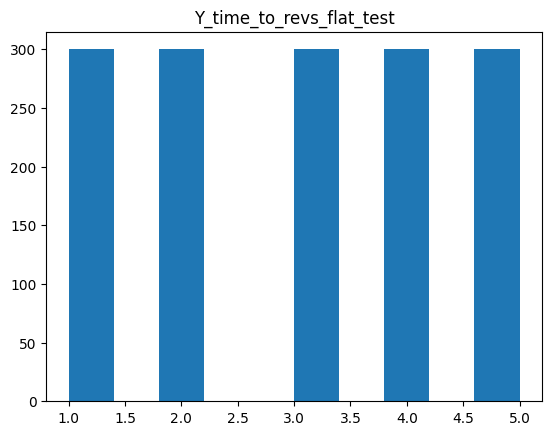

In [11]:
all_timesteps = range(1, 15, 5) #range(1, 15, 3)

feature_list = spont_matched_features
feature_labels = ["spont resamp vel", "spont resamp accel", "spont resamp curv"]
rev_bin = spont_resampled_rev

win_start = 1
win_end = 5
n_splits = 10
test_size = 0.3

fps = 1.6
score_label = "r2 score "
prep_data_fnc = prep_data_spont_rev_latency
model_fit_fnc = fit_eval_lasso
result_visualization_fnc = visualize_model_regression
title_label = "spont latency to rev\n resampled fps"


best_models = predict_spont_revs_from_features(   feature_list, 
                                     feature_labels, rev_bin,
                                     fps, 
                                     win_start, win_end,
                                     model_fit_fnc, 
                                     score_label,
                                     result_visualization_fnc, 
                                     prep_data_fnc, 
                                     
                                     title_label = title_label, 
                                     all_timesteps = all_timesteps, 

                                    n_splits = n_splits,  
                                    test_size = test_size, 

                                    single_feature = False, 
                                    n_pre_start = 0 ) 





all_timesteps = range(1, 25, 5) #range(1, 15, 3)

feature_list = [spont_exp_vel, spont_exp_acc, spont_exp_curve]
feature_labels = ["spont exp vel", "spont exp accel", "spont exp curv"]
rev_bin =  spont_exp_rev


win_start = 1
win_end = 5
n_splits = 10
test_size = 0.3

fps = 6
score_label = "r2 score "
prep_data_fnc = prep_data_spont_rev_latency
model_fit_fnc = fit_eval_lasso
result_visualization_fnc = visualize_model_regression
title_label = "spont latency to rev\n exp fps"


best_models = predict_spont_revs_from_features(   feature_list, 
                                     feature_labels, rev_bin,
                                     fps, 
                                     win_start, win_end,
                                     model_fit_fnc, 
                                     score_label,
                                     result_visualization_fnc, 
                                     prep_data_fnc, 
                                     
                                     title_label = title_label, 
                                     all_timesteps = all_timesteps, 

                                    n_splits = n_splits,  
                                    test_size = test_size, 

                                    single_feature = False, 
                                    n_pre_start = 0 ) 



in load data
[]
NOT using body angle mag for curvature
in replace_outliers_exp
in plot data
in reformar data
flavell_velocity.shahpe (21, 1599)
plotted
exp_acc1 (709200,)
resamplsep_pos_neg_resampleing
exp_acc1.shape) (189120,)

resampled_pause (189120,)
resampling
matching cdfs
in plot data
bins [-3.14159265 -2.51327412 -1.88495559 -1.25663706 -0.62831853  0.
  0.62831853  1.25663706  1.88495559  2.51327412  3.14159265]


/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  ax1.scatter(
/Users/friederikebuck/Downloads/worm notes/worm_code/visualize_donut_time_series_and_states.py:125: UserWarning: *c* argument looks like a single nu

Number of bins: 10
Number of bins: 10
Number of bins: 10
Number of bins: 10
Number of bins: 10
[<Figure size 400x200 with 2 Axes>, <Figure size 1400x400 with 12 Axes>, <Figure size 1800x300 with 18 Axes>, <Figure size 1200x300 with 12 Axes>, <Figure size 1900x700 with 24 Axes>, <Figure size 1600x700 with 24 Axes>]


[<Figure size 400x200 with 2 Axes>,
 <Figure size 1400x400 with 12 Axes>,
 <Figure size 1800x300 with 18 Axes>,
 <Figure size 1200x300 with 12 Axes>,
 <Figure size 1900x700 with 24 Axes>,
 <Figure size 1600x700 with 24 Axes>]

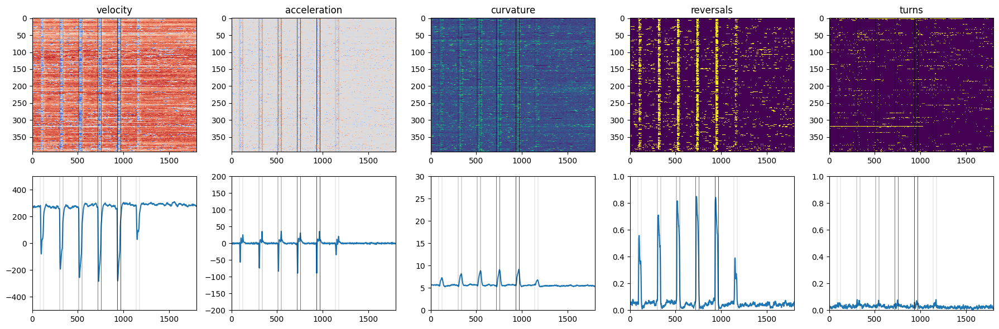

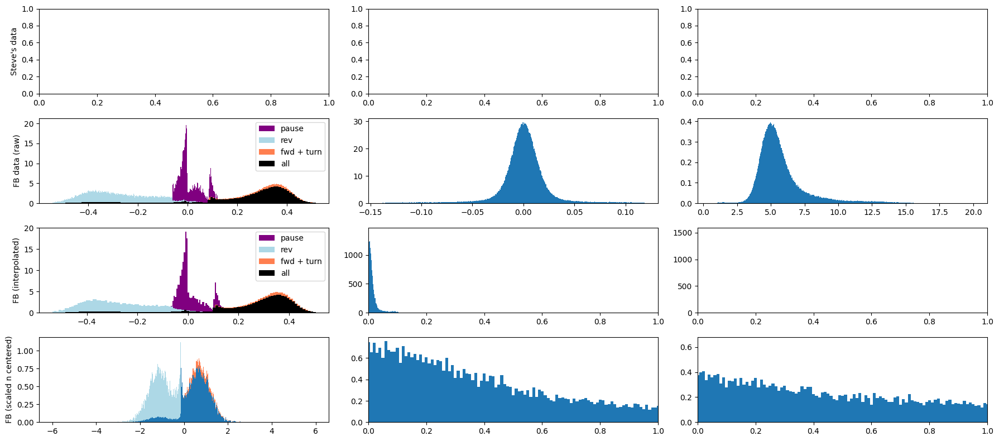

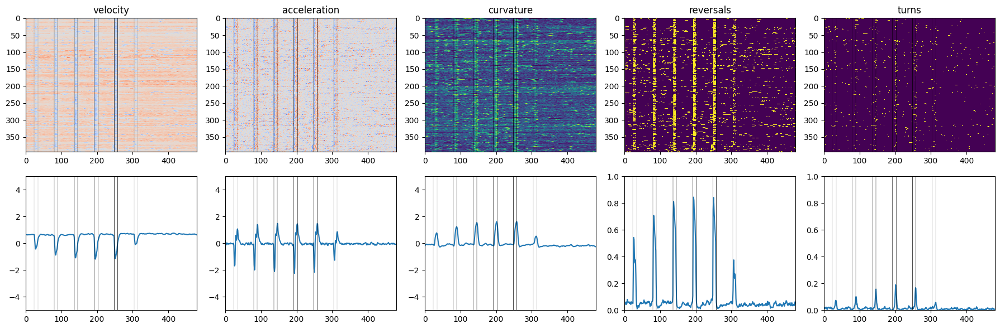

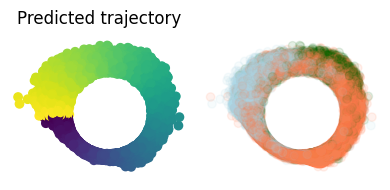

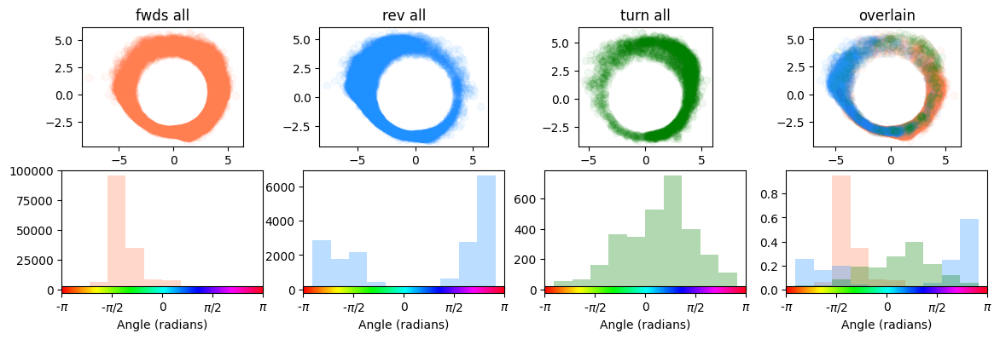

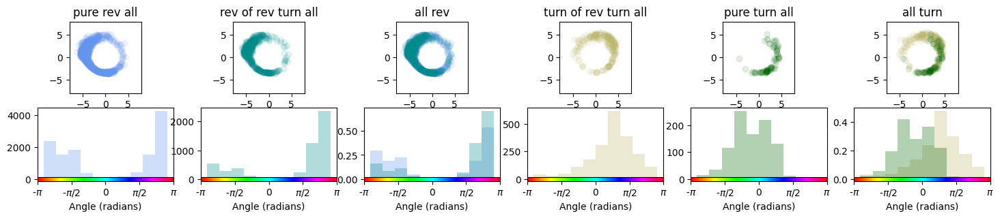

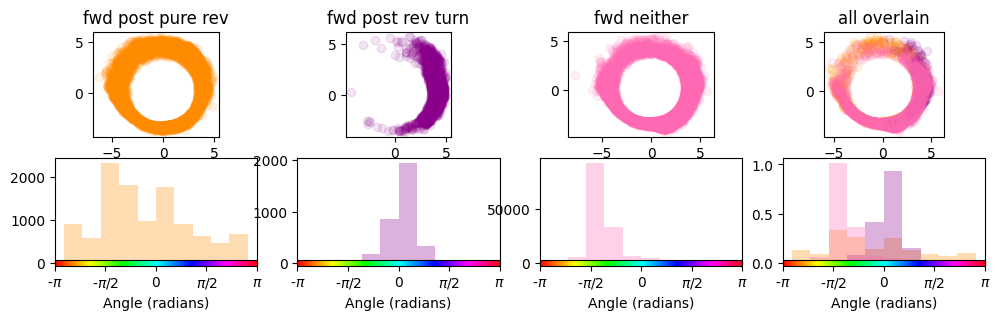

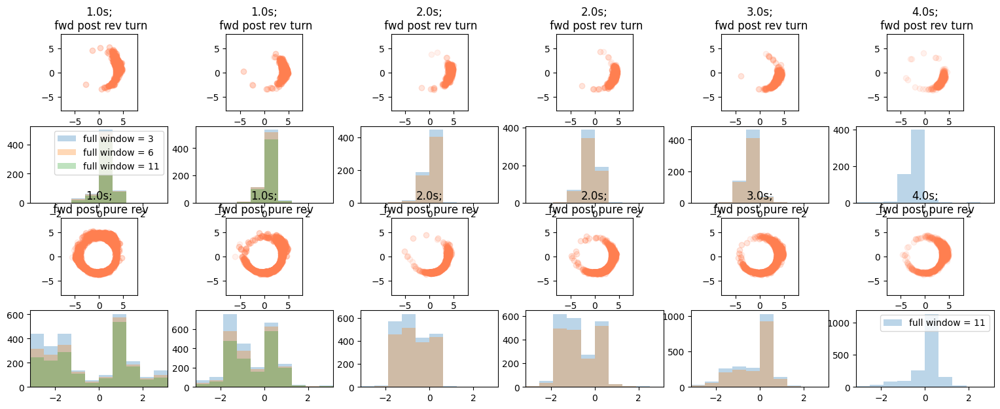

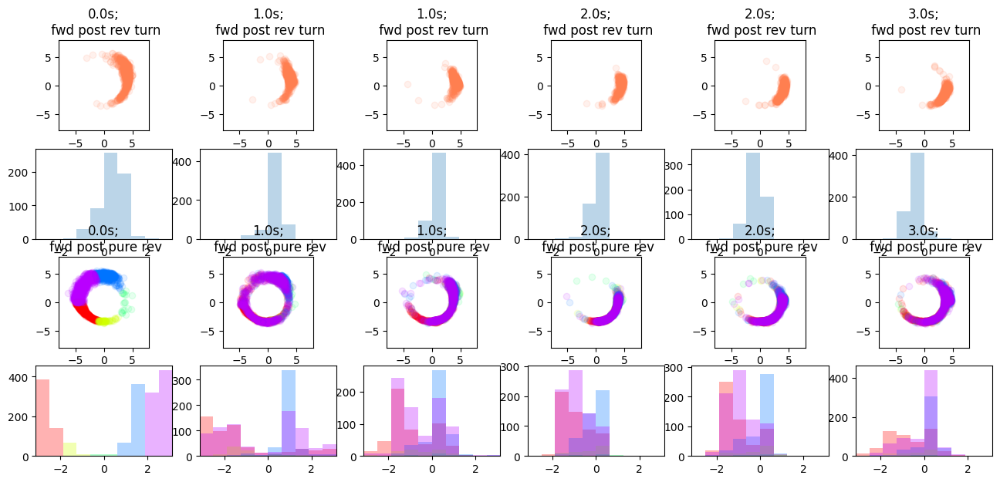

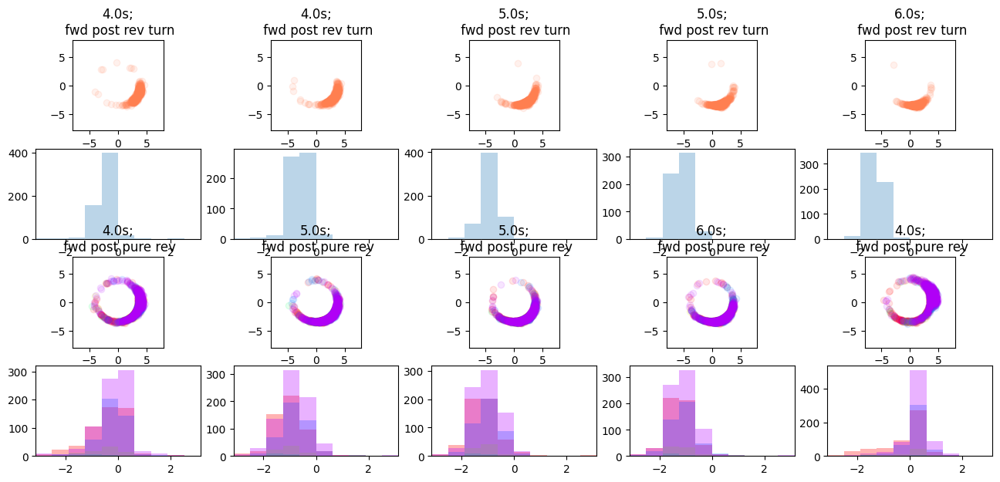

In [12]:
from visualize_donut_time_series_and_states import plot_donut_beh_figs_1
import pickle 
pickle_fname = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/worm_angles_concat_neural.pickle"
with open(pickle_fname, "rb") as handle:
    worm_angles_concat_neural, worm_radii_concat_neural, model_neural_directed = pickle.load(handle) 
    



pickle_fname = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/worm_angles_concat_beh.pickle"
with open(pickle_fname, "rb") as handle:
   worm_angles, worm_radii, model_beh_directed =  pickle.load( handle) 
    
    
from load_and_process_FB_data_fncs_8 import load_data, reformat_data,plot_data,  analyze_data, replace_outliers_exp, reformat_data_1
# experiment = "duty_cycle"
# condition = "exp"
# neuron = "AVA"
# path = "/Users/friederikebuck/beh_analysis_results/csv/_Aim1_AVA_duty_cycle/"


# experiment = "duty_cycle"
# condition = "exp"
# neuron = "AIB"
# path = "/Users/friederikebuck/beh_analysis_results/csv/_AIBC-3_Aim1_AIB_duty_cycle/"


experiment = "duty_cycle"
condition = "exp"
neuron = "RIM"
path = "/Users/friederikebuck/beh_analysis_results/csv/_Aim1_RIM_duty_cycle/"

from load_and_process_FB_data_fncs_8 import  causal_moving_average,plot_data,   reformat_data_1, replace_outliers_exp, replace_outliers_neg_post_seperate_and_resample, smooth_trace,replace_outliers_and_resample,resample_binary,   match_cdf 


exp_data = load_data(experiment, condition, neuron, path = path)


stim_exp_vel, stim_exp_acc, stim_exp_curve, stim_exp_rev, stim_exp_pause, stim_exp_turn, stim_exp_body_angle_mag  = replace_outliers_exp(exp_data, exp_data[0].shape)

exp_onsets = plot_data(stim_exp_vel, stim_exp_acc, stim_exp_curve, stim_exp_rev, stim_exp_pause, experiment, fps=6)

stim_resampled_rev, stim_resampled_turn,stim_resampled_features,  stim_smooth_features, stim_matched_features = reformat_data_1(stim_exp_vel, 
                                                                                             stim_exp_acc,
                                                                                             stim_exp_curve,
                                                                                             stim_exp_rev,
                                                                                             stim_exp_turn, 
                                                                                             stim_exp_pause,
                                                                                             z_flat,
                                                                                             velocity, 
                                                                                             acceleration, 
                                                                                             worm_curvature,
                                                                                             plot=True, 
                                                                                             replace_outliers = True, 
                                                                                             sep_pos_neg_resample = True, match_vel_only = True
                                                                                             )

stim_resampled_vel, stim_resampled_acc, stim_resampled_curve = stim_resampled_features
stim_smooth_vel, stim_smooth_acc, stim_smooth_curve = stim_smooth_features
stim_matched_vel, stim_matched_acc, stim_matched_curve = stim_matched_features


onsets = plot_data(stim_matched_vel, stim_matched_acc, stim_matched_curve, stim_resampled_rev, stim_resampled_turn, experiment, fps=1.6, orig = False)
resampled_onsets = onsets

inferred_phases, final_behaviors, final_behaviors_all, inferred_phases_all, inferred_rad_all, behaviors_all, inferred_rad, initial_behaviors, initial_cts_beh, X_all_LSTM = analyze_data(stim_matched_vel,
                                                                                                                                                                                         stim_matched_acc, 
                                                                                                                                                                                         stim_matched_curve, 
                                                                                                                                                                                         stim_resampled_rev, 
                                                                                                                                                                                         stim_resampled_turn, 
                                                                                                                                                                                         onsets, 
                                                                                                                                                                                         model_beh_directed,  
                                                                                                                                                                                         z_norm,input_stats,  
                                                                                                                                                                                         z,   
                                                                                                                                                                                         lag=16, 
                                                                                                                                                                                         inclusion_thresh = 2, 
                                                                                                                                                                                         model_type="ff", 
                                                                                                                                                                                         remove_revs=False
                                                                                                                                                                                         
                                                                                                                                                                                         )
beh_all_org = (behaviors_all*  np.array(z).std())+ np.array(z).mean()

plot_donut_beh_figs_1(inferred_phases_all,inferred_rad_all,  beh_all_org,

                         cmap,
                            n_bins = 10, 
                         window = 5)



    

# Plot all worms -- LSTM

In [13]:
# from predict_latency_prob_from_features_donut import fit_eval_linearSVC, plot_coeffs, prep_FB_inputs_select_features_only_no_onset, visualize_model_classification ##Real ** 
# from predict_latency_prob_from_features_donut import fit_eval_lasso

In [14]:


from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso, TweedieRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn import tree
import warnings
from predict_latency_prob_from_features_donut import prep_FB_inputs, fit_visualize_model_classifiction, prep_FB_inputs_features_only, latency_to_reversal
from predict_latency_prob_from_features_donut import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only, feature_all_to_resampled, resample_2d
# # from predict_latency_prob_from_features_donut_6 import visualize_model_classification, combine_FB_features_across_stim, prep_FB_inputs_select_features_only, latency_to_reversal, fit_visualize_model_regression
from predict_latency_prob_from_features_donut import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only

from predict_latency_prob_from_features_donut import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only
from predict_latency_prob_from_features_donut import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only
from predict_latency_prob_from_features_donut import visualize_model_classification, combine_FB_features_across_stim
from predict_latency_prob_from_features_donut import prep_FB_inputs_feature_and_donut, prep_FB_inputs_features_only
# from predict_latency_prob_from_features_donut import visualize_model_classification, combine_FB_features_across_stim

from predict_latency_prob_from_features_donut import prep_data_rev_prob, get_plot_multi_stim_model, get_plot_multi_stim_model_single_feature

from predict_latency_prob_from_features_donut import prep_FB_inputs_select_features_only, prep_FB_inputs_features_only, feature_all_to_resampled



if experiment == "time_titration":
    durations = [1,3,5,10]
else:
    durations = [5,5,5,5,5,5]
    if experiment == "hiscl":
        durations = [5,5]

beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]
resampled_timesteps1 = np.arange(1,20, 2)

In [15]:
# if experiment == "time_titration":
#     durations = [1,3,5,10]
# else:
#     durations = [5,5,5,5,5,5]
#     if experiment == "hiscl":
#         durations = [5,5]

# exp_offsets = np.array([exp_onsets[i] + 6*durations[i] for i in range(len(durations))])


# fig,ax = plt.subplots(1,len(durations))
# fig2,ax2 = plt.subplots()

# latencies = []
# for i in range(len(durations)):
#     latency = latency_to_reversal(exp_rev, exp_onsets[i], max_latency = 6*durations[i]+1)
#     idx = np.argsort(latency)
#     ax[i].imshow(stim_exp_rev[idx, -10+exp_onsets[i]:exp_offsets[i]+10], aspect="auto")
#     ax[i].axvline(10, c='r')
#     ax[i].axvline(10+6*durations[i], c='r')
#     ax2.hist(latency/6, bins = np.arange(0,10,.3), alpha = 0.5, label=i)
#     # latency[np.isnan(latency)] = np.nanmax(latency)+1
#     latencies.append(latency)
# fig.tight_layout()
# latencies = np.array(latencies)/6
# ax2.legend()

In [16]:
# ###############
# ###############checkk get donut stim works** 
# ###get inputs into lstm 
# ###############



In [17]:

print(resampled_timesteps)

[ 1  4  7 10 13 16 19]


i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 3
i, n_timesteps 1 3
i, n_timesteps 2 3
i, n_timesteps 3 3
i, n_timesteps 4 3
i, n_timesteps 5 3
i, n_timesteps 0 5
i, n_timesteps 1 5
i, n_timesteps 2 5
i, n_timesteps 3 5
i, n_timesteps 4 5
i, n_timesteps 5 5
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 9
i, n_timesteps 1 9
i, n_timesteps 2 9
i, n_timesteps 3 9
i, n_timesteps 4 9
i, n_timesteps 5 9
i, n_timesteps 0 11
i, n_timesteps 1 11
i, n_timesteps 2 11
i, n_timesteps 3 11
i, n_timesteps 4 11
i, n_timesteps 5 11
i, n_timesteps 0 13
i, n_timesteps 1 13
i, n_timesteps 2 13
i, n_timesteps 3 13
i, n_timesteps 4 13
i, n_timesteps 5 13
i, n_timesteps 0 15
i, n_timesteps 1 15
i, n_timesteps 2 15
i, n_timesteps 3 15
i, n_timesteps 4 15
i, n_timesteps 5 15
i, n_timesteps 0 17
i, n_timesteps 1 17
i, n_timesteps 2 17
i, n_times

/Users/friederikebuck/Downloads/worm notes/worm_code/predict_latency_prob_from_features_donut.py:1450: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


(1547,)
Accuracy: 0.9804216867469879
Precision: 0.9807404468755868
Recall: 0.9804216867469879
F1 Score: 0.9805110353845726
(1547,)
Accuracy: 0.9819277108433735
Precision: 0.9819277108433735
Recall: 0.9819277108433735
F1 Score: 0.9819277108433735
(1547,)
Accuracy: 0.983433734939759
Precision: 0.9834702992123314
Recall: 0.983433734939759
F1 Score: 0.9834491620785197
(1547,)
i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 3
i, n_timesteps 1 3
i, n_timesteps 2 3
i, n_timesteps 3 3
i, n_timesteps 4 3
i, n_timesteps 5 3
i, n_timesteps 0 5
i, n_timesteps 1 5
i, n_timesteps 2 5
i, n_timesteps 3 5
i, n_timesteps 4 5
i, n_timesteps 5 5
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 9
i, n_timesteps 1 9
i, n_timesteps 2 9
i, n_timesteps 3 9
i, n_timesteps 4 9
i, n_timesteps 5 9
i, n_timesteps 0 11
i, n_timesteps 1 11
i, n_timesteps 

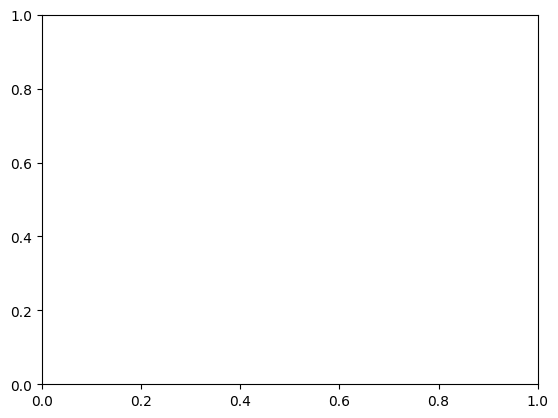

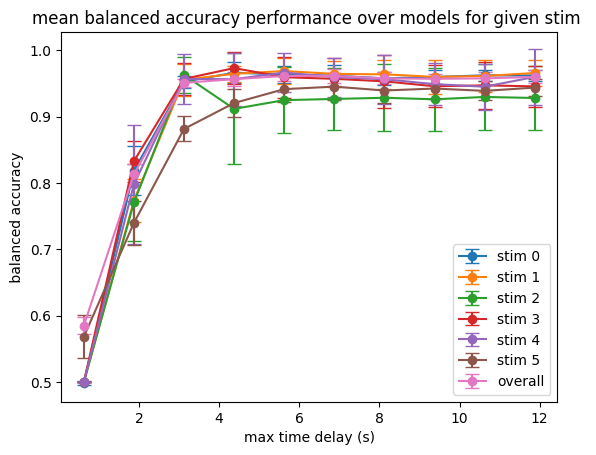

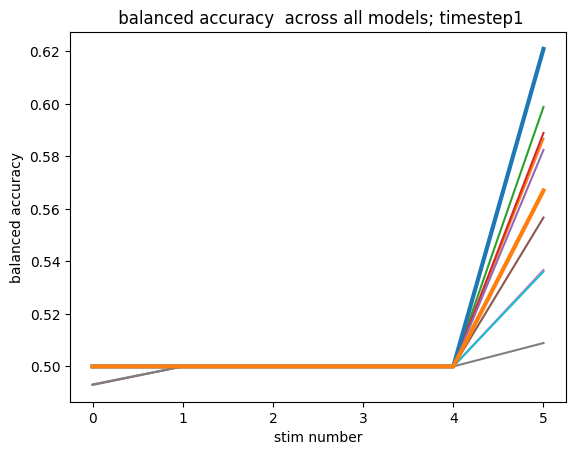

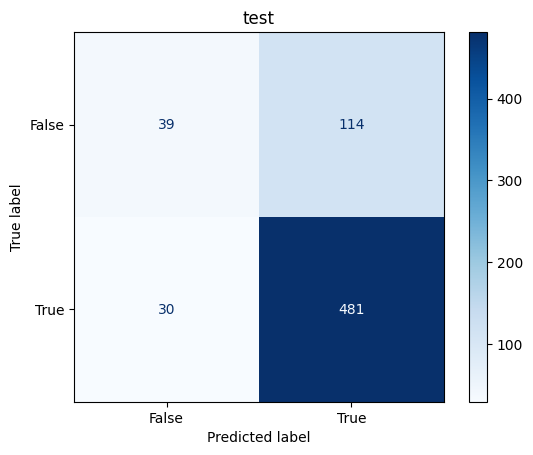

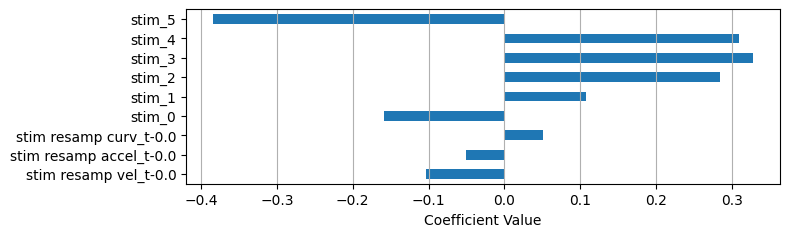

...

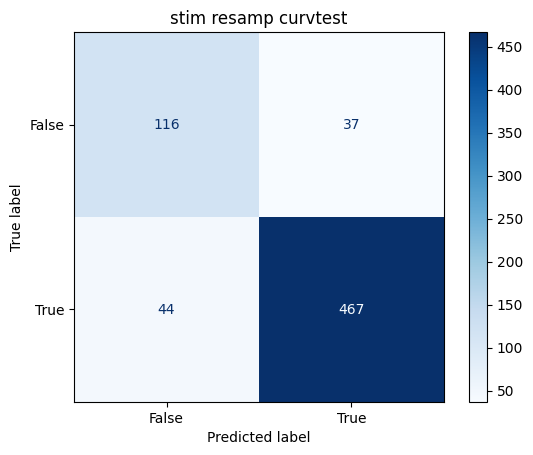

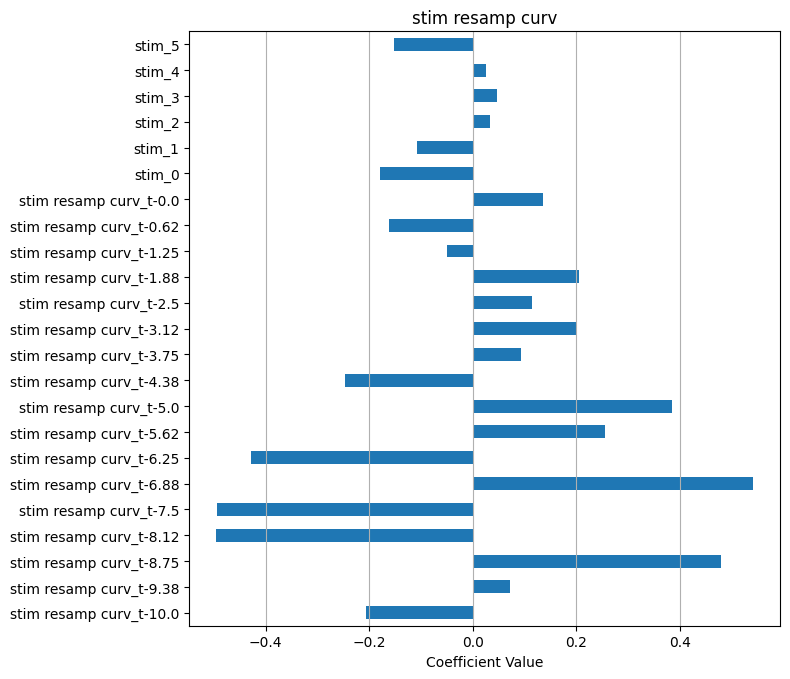

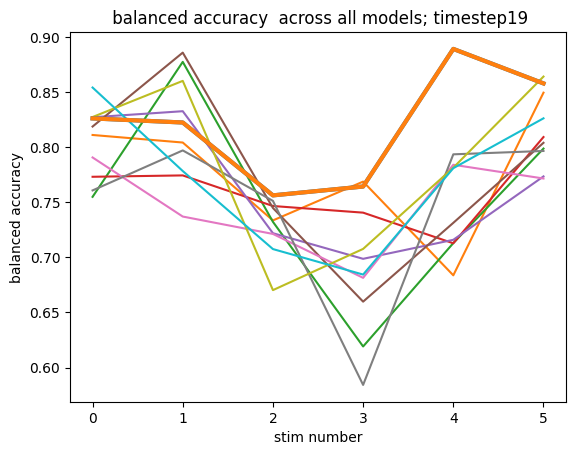

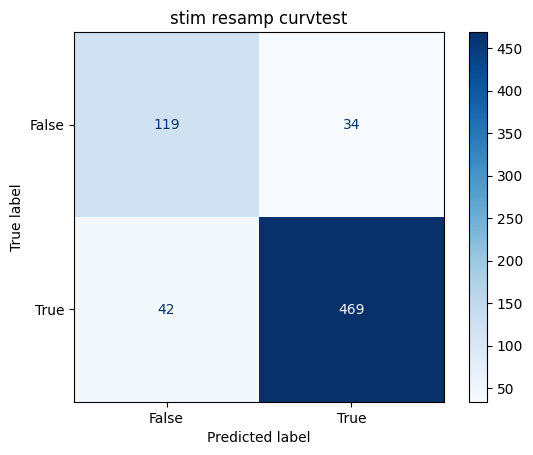

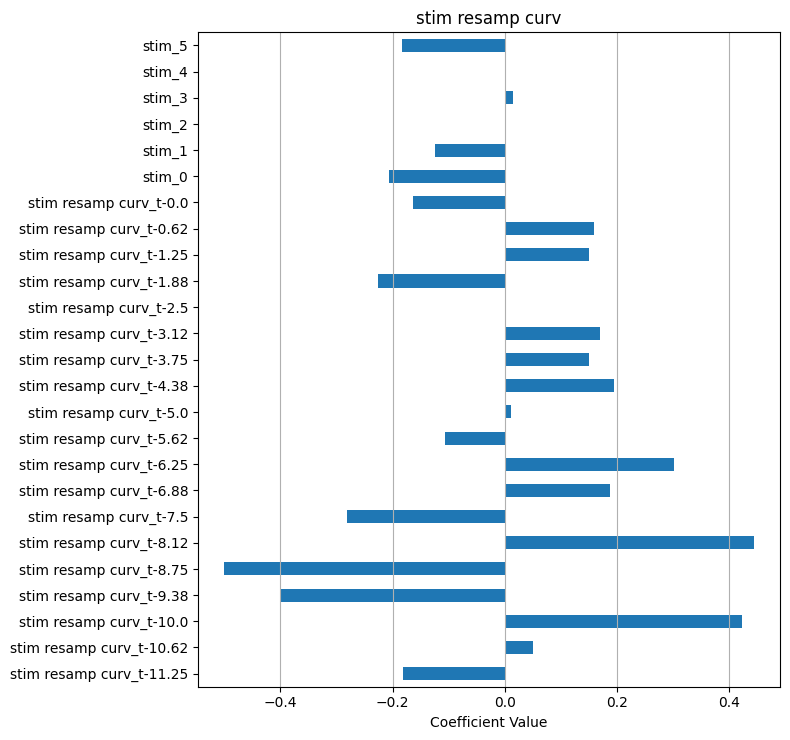

In [18]:
# if experiment == "time_titration":
#     durations = [1,3,5,10]
# else:
#     durations = [5,5,5,5,5,5]
#     if experiment == "hiscl":
#         durations = [5,5]

# resampled_timesteps1 = np.arange(1,20, 2)

resampled_onsets = onsets
'''####get rev prob; all stim ; resampled  all beh feature s'''
feature_list = stim_matched_features #[resampled_vel, resampled_acc, resampled_curve]
feature_labels = ["stim resamp vel", "stim resamp accel", "stim resamp curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
score_fnc = balanced_accuracy_score
data_onsets = resampled_onsets
score_label = "balanced accuracy"
title_label = f"{neuron}; Reversal prediction;\n resampled fps; all beh features; Mean ± STD balanced accuracy"
fps = 1.6

best_model_score_stim_min, t_to_best_model_using_min_idx_score, t_to_all_data, t_to_all_feature_names  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps1, 
                                                    check_warnings = True
                                                                        )

'''####get rev prob; all stim ; resampled fps; all single features'''

title_label = f"{neuron}; Reversal prediction;\n resampled; all beh features; Mean ± STD balanced accuracy"

feature_to_best_models  = get_plot_multi_stim_model_single_feature(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps1, 
                                                    check_warnings = True
                                                    )

In [19]:
print(exp_timesteps)

[ 1  4  7 10 13 16 19 22 25 28 31 34 37]


In [20]:
from predict_latency_prob_from_features_donut_3 import prep_data_rev_prob, get_plot_multi_stim_model, get_plot_multi_stim_model_single_feature

'''####get rev prob; all stim ; exp fps;  all single features'''
feature_list = [stim_exp_vel, stim_exp_acc, stim_exp_curve]
feature_labels = ["stim exp vel", "stim exp accel", "stim exp curv"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
data_onsets = exp_onsets
title_label = f"{neuron}; Reversal prob;\n all features exp fps; Mean ± STD balanced accuracy"
fps = 6
score_label = "balanced accuracy"
score_fnc = balanced_accuracy_score

'''####get rev prob; all stim ; exp fps;  all features'''
best_model_score_stim_min, t_to_best_model_using_min_idx_score, t_to_all_data, t_to_all_feature_names  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = exp_timesteps, 
                                                    check_warnings = True
                                                                        )

'''####get rev prob; all stim ; exp fps;  all single features'''
title_label = f"{neuron}; Reversal prediction;\n exp fps; all beh features; Mean ± STD balanced accuracy"

feature_to_best_models  = get_plot_multi_stim_model_single_feature(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = exp_timesteps, 
                                                    check_warnings = True
                                                    )

ModuleNotFoundError: No module named 'predict_latency_prob_from_features_donut_3'

In [ ]:
'''####get rev prob; all stim ; resampled fps phase;  '''

n_tracks = stim_resampled_rev.shape[0]
phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
feature_list = [phase_resampled, radii_resampled]
feature_labels = ["stim resamp phase", "stim resamp radii"]
data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
score_fnc = balanced_accuracy_score
data_onsets = resampled_onsets
score_label = "balanced accuracy"
title_label = f"{neuron}; Reversal prediction;\n resampled fps; phase; Mean ± STD balanced accuracy"
fps = 1.6

best_model_score_stim_min, t_to_best_model_using_min_idx_score, t_to_all_data, t_to_all_feature_names  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps1, 
                                                    check_warnings = True
                                                                        )


n_timesteps 459
n_timesteps 459


NameError: name 'durations' is not defined

i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 10
i, n_timesteps 1 10
i, n_timesteps 2 10
i, n_timesteps 3 10
i, n_timesteps 4 10
i, n_timesteps 5 10
i, n_timesteps 0 13
i, n_timesteps 1 13
i, n_timesteps 2 13
i, n_timesteps 3 13
i, n_timesteps 4 13
i, n_timesteps 5 13
i, n_timesteps 0 16
i, n_timesteps 1 16
i, n_timesteps 2 16
i, n_timesteps 3 16
i, n_timesteps 4 16
i, n_timesteps 5 16
i, n_timesteps 0 19
i, n_timesteps 1 19
i, n_timesteps 2 19
i, n_timesteps 3 19
i, n_timesteps 4 19
i, n_timesteps 5 19
(690,)
(690,)
(690,)
(690,)
(690,)
(690,)


/Users/friederikebuck/Downloads/worm notes/worm_code/predict_latency_prob_from_features_donut_3.py:1421: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


(690,)
i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 10
i, n_timesteps 1 10
i, n_timesteps 2 10
i, n_timesteps 3 10
i, n_timesteps 4 10
i, n_timesteps 5 10
i, n_timesteps 0 13
i, n_timesteps 1 13
i, n_timesteps 2 13
i, n_timesteps 3 13
i, n_timesteps 4 13
i, n_timesteps 5 13
i, n_timesteps 0 16
i, n_timesteps 1 16
i, n_timesteps 2 16
i, n_timesteps 3 16
i, n_timesteps 4 16
i, n_timesteps 5 16
i, n_timesteps 0 19
i, n_timesteps 1 19
i, n_timesteps 2 19
i, n_timesteps 3 19
i, n_timesteps 4 19
i, n_timesteps 5 19
(690,)
(690,)
(690,)
(690,)
(690,)
(690,)
(690,)
i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_tim

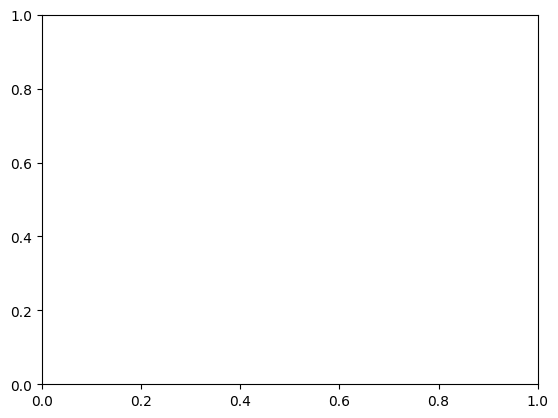

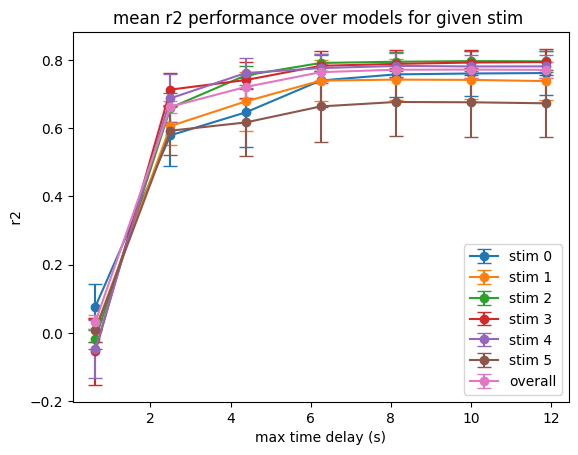

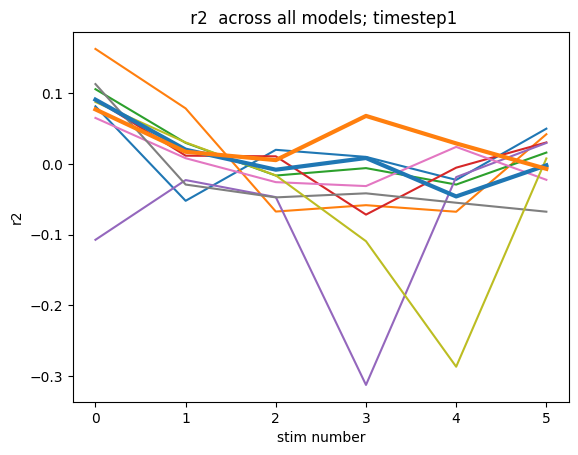

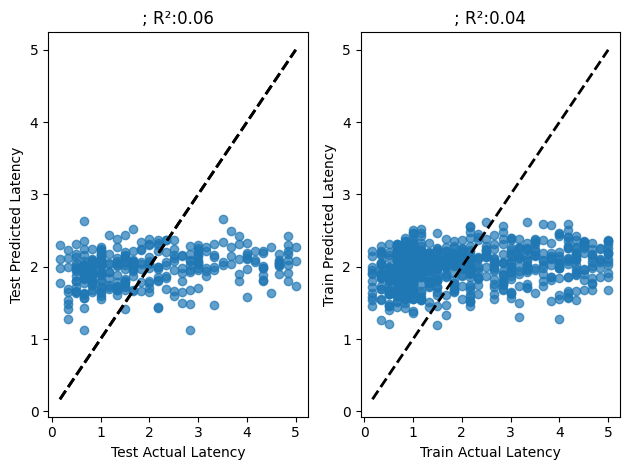

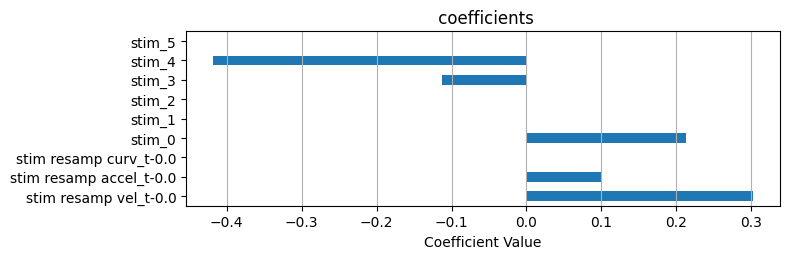

...

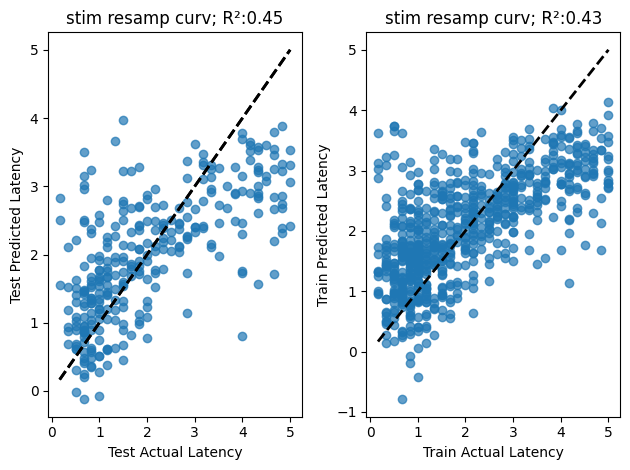

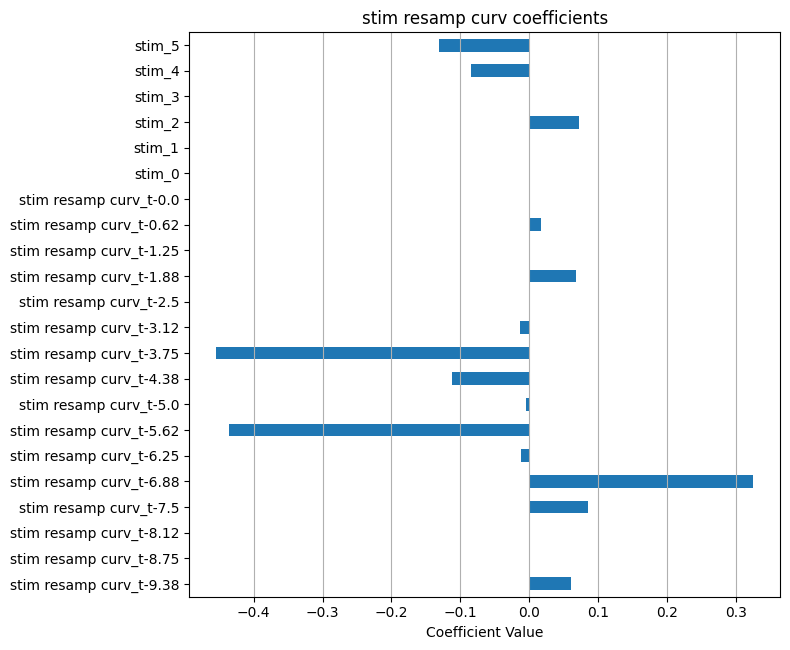

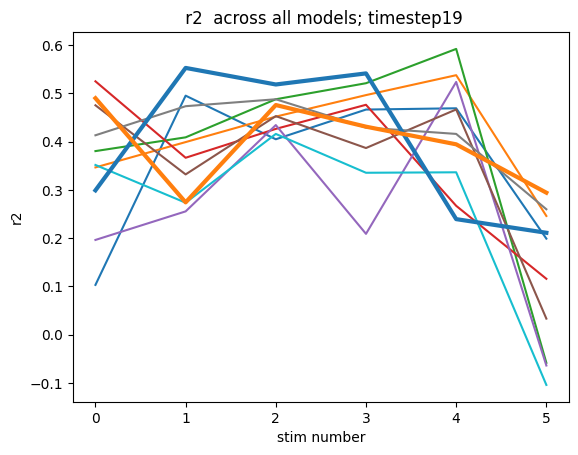

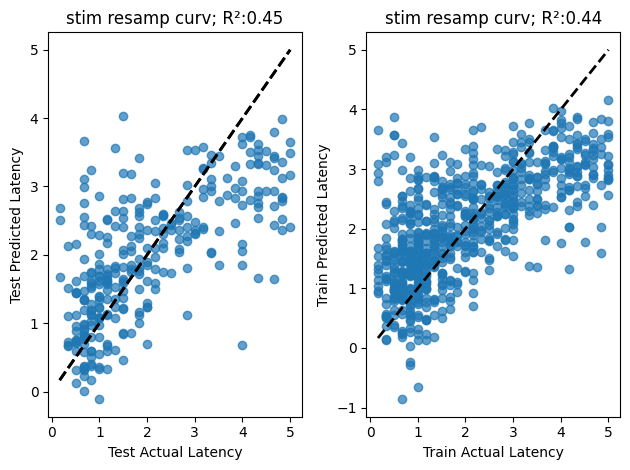

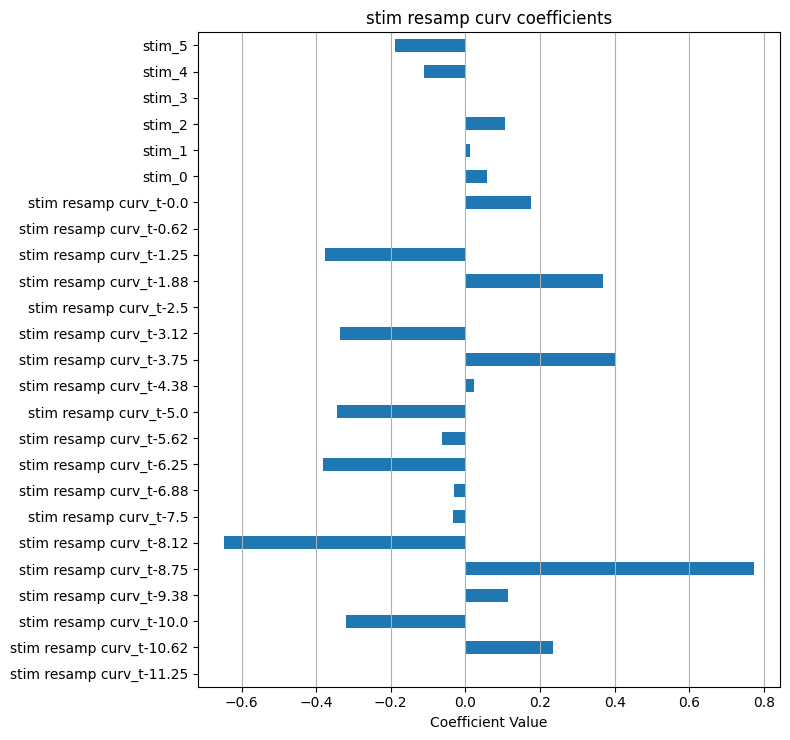

In [ ]:


from predict_latency_prob_from_features_donut_3 import prep_data_latency, visualize_model_regression, r2_score
feature_list = stim_matched_features #[resampled_vel, resampled_acc, resampled_curve]
feature_labels = ["stim resamp vel", "stim resamp accel", "stim resamp curv"]
data_prep_fnc = prep_data_latency
model_fit_fnc = fit_eval_lasso
result_visualization_fnc = visualize_model_regression
score_fnc = r2_score
data_onsets = resampled_onsets
score_label="r2"
title_label = f"{neuron}; Reversal latency;\n all features resamppled; Mean ± STD balanced accuracy"
fps = 1.6

'''####get rev latency; all stim ; resampled fps;  all features'''
feature_to_best_models  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps1, 
                                                    check_warnings = True
                                                    )

'''####get rev latency; all stim ; resampled fps;  all single features'''

title_label = f"{neuron}; Reversal latency;\n single features; Mean ± STD balanced accuracy"
feature_to_best_models  = get_plot_multi_stim_model_single_feature(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps1, 
                                                    check_warnings = True
                                                    )


i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 10
i, n_timesteps 1 10
i, n_timesteps 2 10
i, n_timesteps 3 10
i, n_timesteps 4 10
i, n_timesteps 5 10
i, n_timesteps 0 13
i, n_timesteps 1 13
i, n_timesteps 2 13
i, n_timesteps 3 13
i, n_timesteps 4 13
i, n_timesteps 5 13
Accuracy: 0.5952380952380952
Precision: 0.6073746227001959
Recall: 0.5952380952380952
F1 Score: 0.586002456538171
(1370,)
Accuracy: 0.5935374149659864
Precision: 0.603026066195709
Recall: 0.5935374149659864
F1 Score: 0.5877682685977618
(1370,)
Accuracy: 0.6377551020408163
Precision: 0.6403418457026261
Recall: 0.6377551020408163
F1 Score: 0.6372675923016963
(1370,)
Accuracy: 0.6479591836734694
Precision: 0.647989417

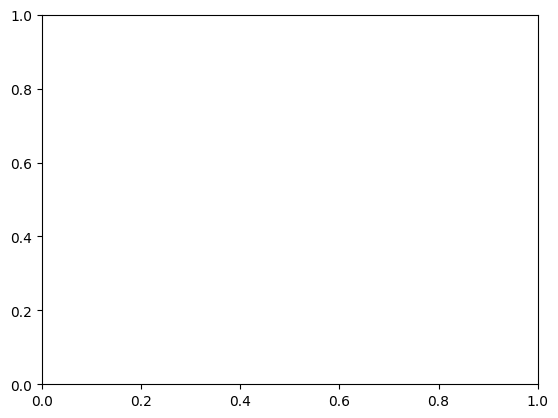

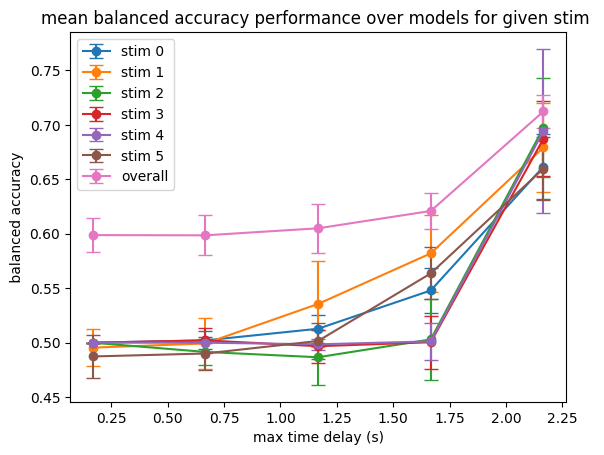

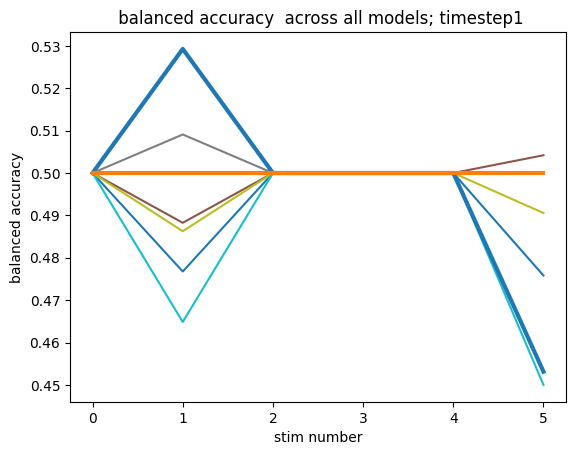

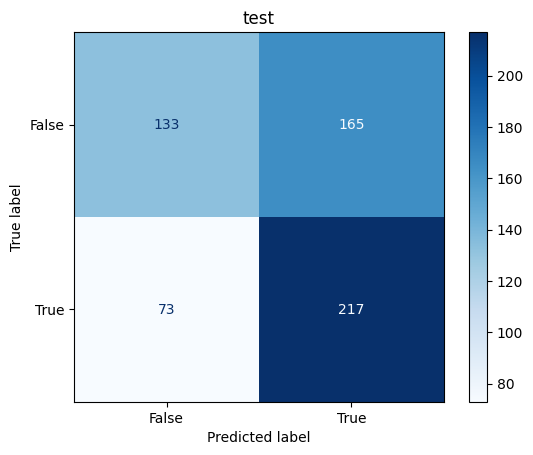

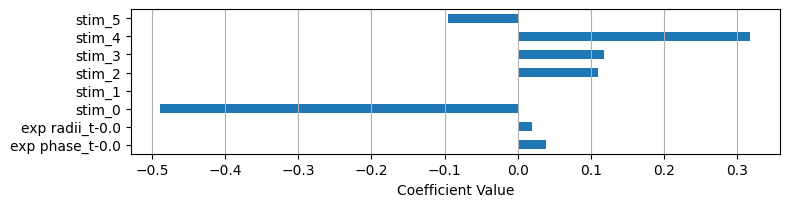

...

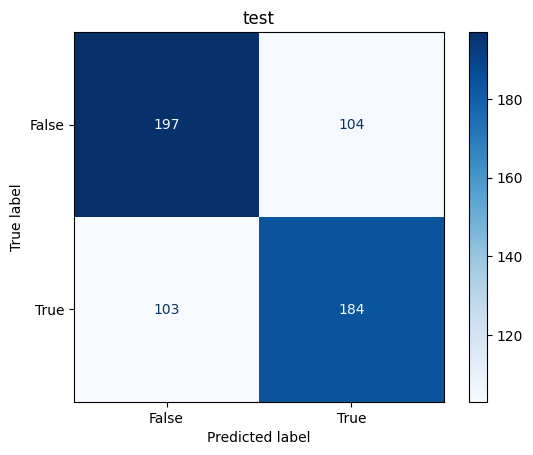

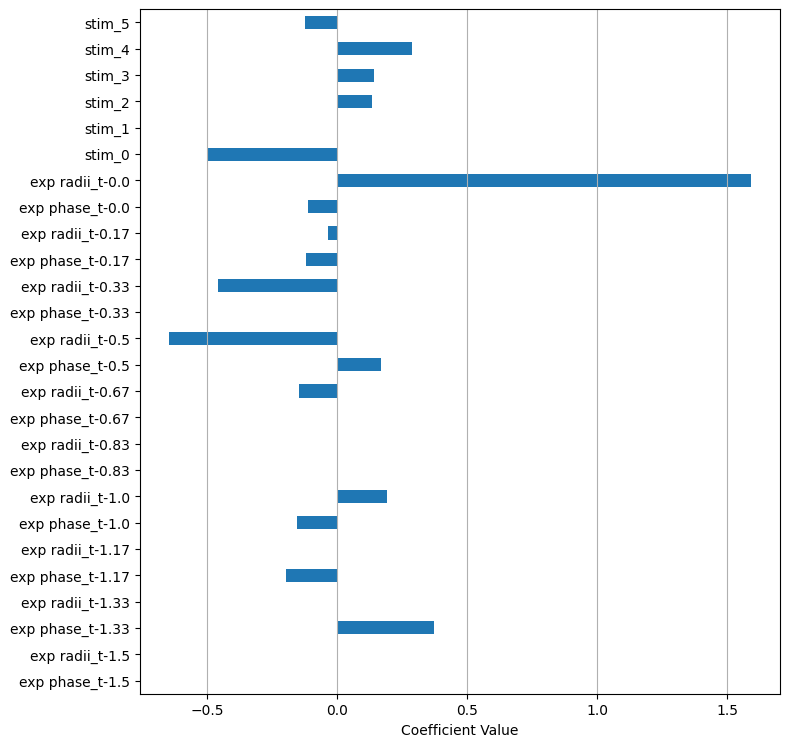

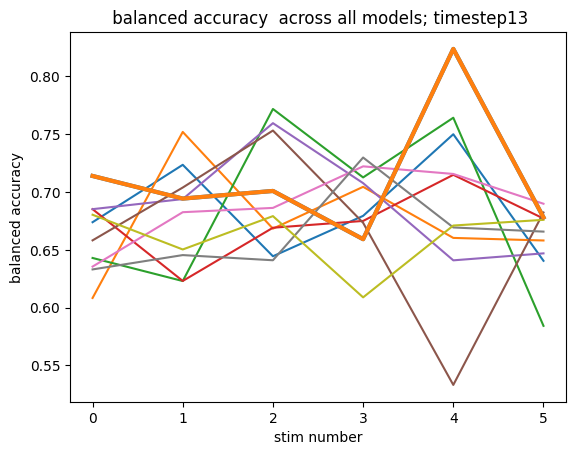

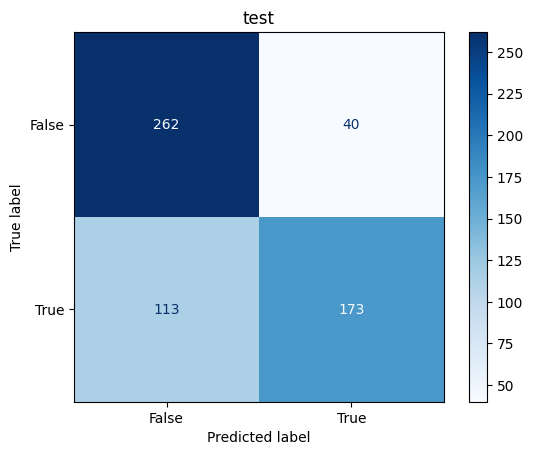

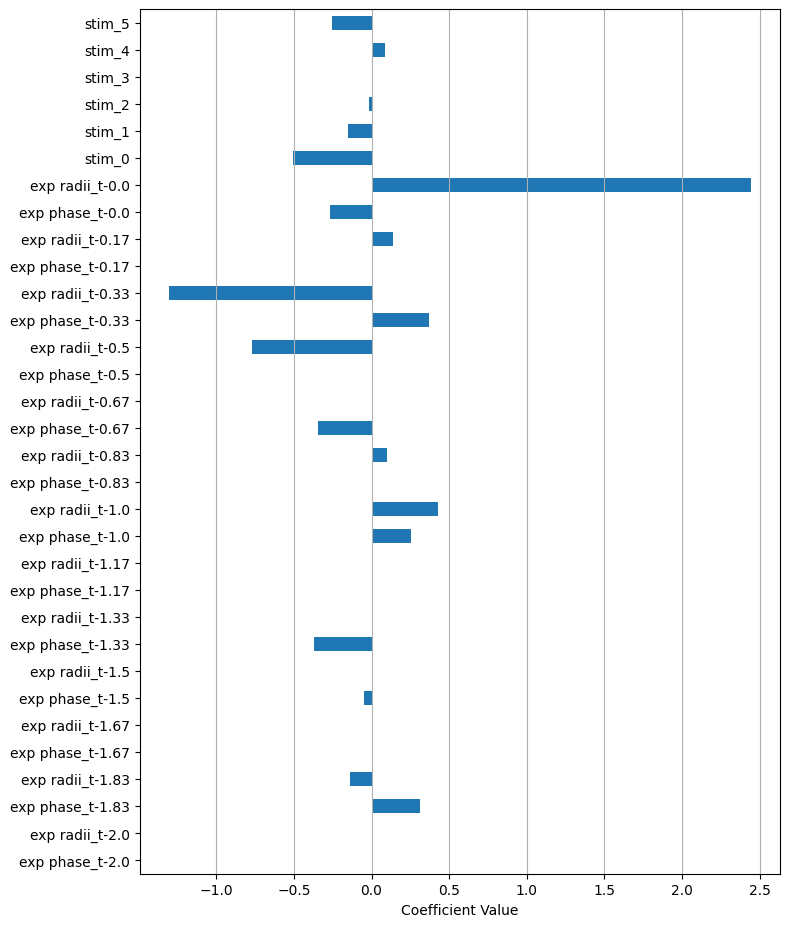

In [ ]:

'''####get rev prob; all stim ; exp phase;  '''

####get rev prob; exp phase  resampled  all beh feature s
exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
exp_rad_high_fps = resample_2d(radii_resampled, target_fps=6, original_fps=1.6)
feature_list = [exp_phase_high_fps, exp_rad_high_fps]
feature_labels = ["exp phase", "exp radii"]

data_prep_fnc = prep_data_rev_prob
model_fit_fnc = fit_eval_linearSVC
result_visualization_fnc = visualize_model_classification
score_fnc = balanced_accuracy_score
data_onsets = exp_onsets
score_label = "balanced accuracy"
title_label = f"{neuron};all stim Reversal prob;\n phase and radiii exp fps; Mean ± STD balanced accuracy"
fps = 6
lstm_lag = 0


best_model_score_stim_min, t_to_best_model_using_min_idx_score, t_to_all_data, t_to_all_feature_names  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps1, 
                                                    check_warnings = True
                                                                        )

i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 10
i, n_timesteps 1 10
i, n_timesteps 2 10
i, n_timesteps 3 10
i, n_timesteps 4 10
i, n_timesteps 5 10
i, n_timesteps 0 13
i, n_timesteps 1 13
i, n_timesteps 2 13
i, n_timesteps 3 13
i, n_timesteps 4 13
i, n_timesteps 5 13
(690,)
(690,)
(690,)
(690,)
(690,)
i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 10
i, n_timesteps 1 10
i

/Users/friederikebuck/Downloads/worm notes/worm_code/predict_latency_prob_from_features_donut_3.py:153: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1,2)


(690,)
(690,)
(690,)
(690,)
(690,)
i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_timesteps 0 10
i, n_timesteps 1 10
i, n_timesteps 2 10
i, n_timesteps 3 10
i, n_timesteps 4 10
i, n_timesteps 5 10
i, n_timesteps 0 13
i, n_timesteps 1 13
i, n_timesteps 2 13
i, n_timesteps 3 13
i, n_timesteps 4 13
i, n_timesteps 5 13
(690,)
(690,)
(690,)
(690,)
(690,)
i, n_timesteps 0 1
i, n_timesteps 1 1
i, n_timesteps 2 1
i, n_timesteps 3 1
i, n_timesteps 4 1
i, n_timesteps 5 1
i, n_timesteps 0 4
i, n_timesteps 1 4
i, n_timesteps 2 4
i, n_timesteps 3 4
i, n_timesteps 4 4
i, n_timesteps 5 4
i, n_timesteps 0 7
i, n_timesteps 1 7
i, n_timesteps 2 7
i, n_timesteps 3 7
i, n_timesteps 4 7
i, n_timesteps 5 7
i, n_t

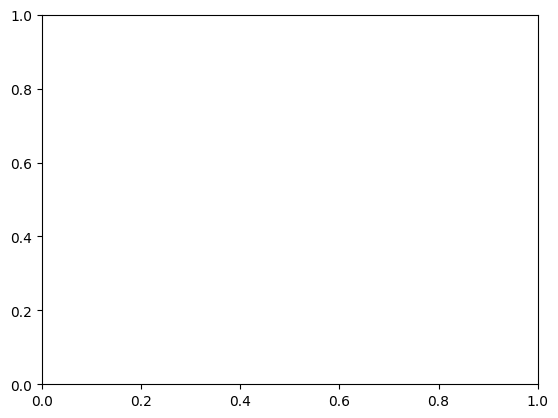

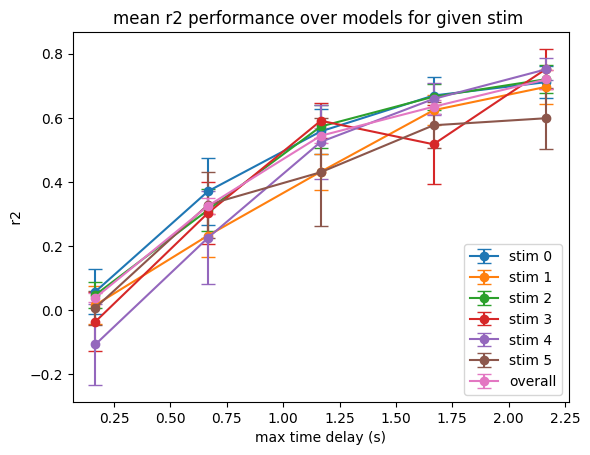

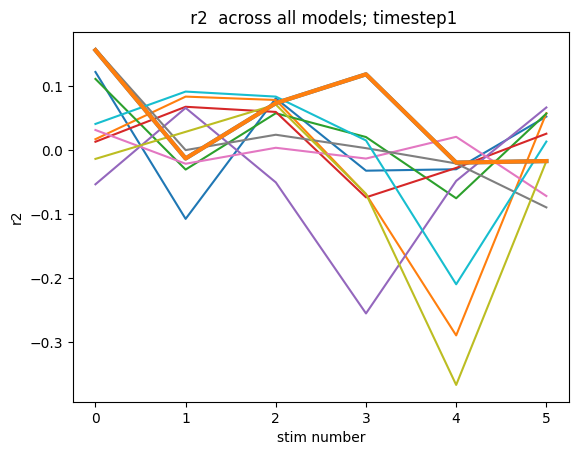

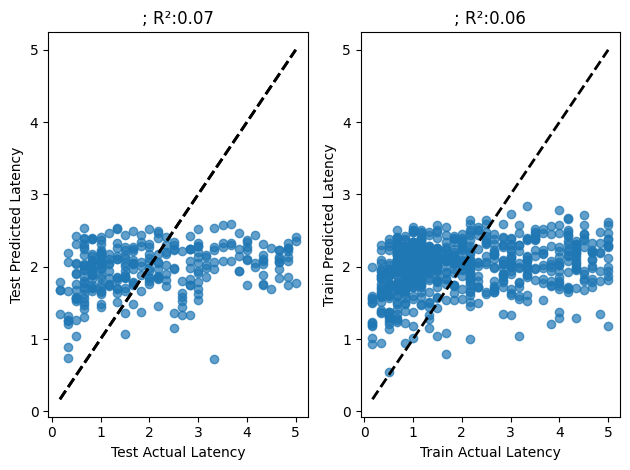

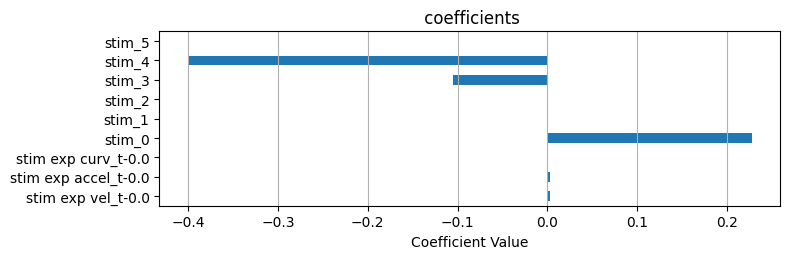

...

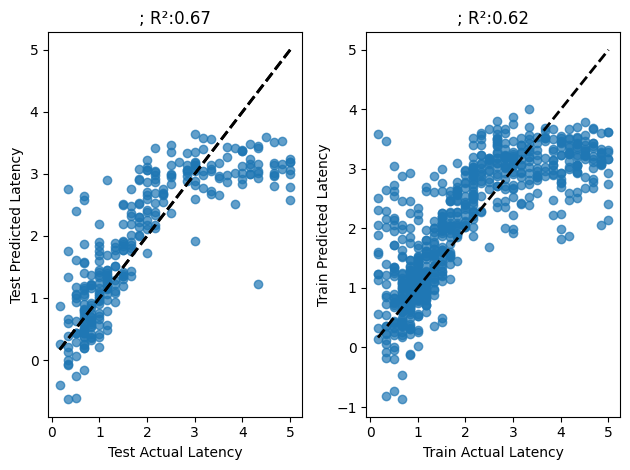

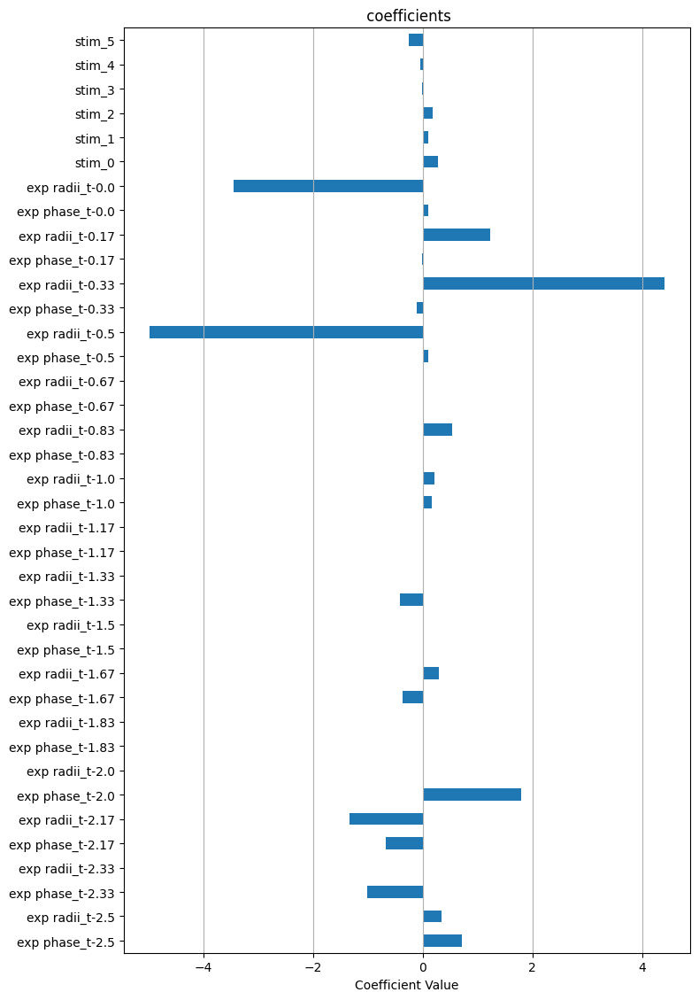

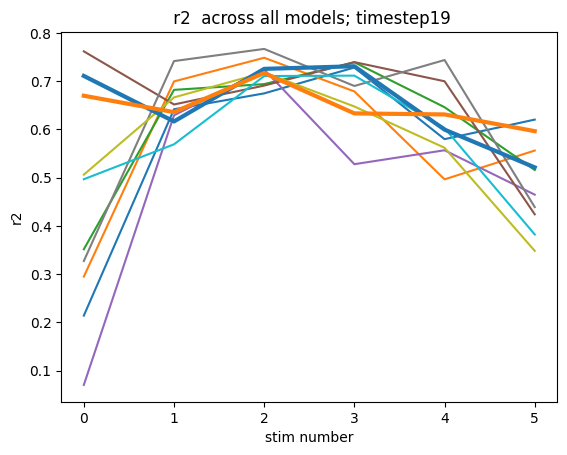

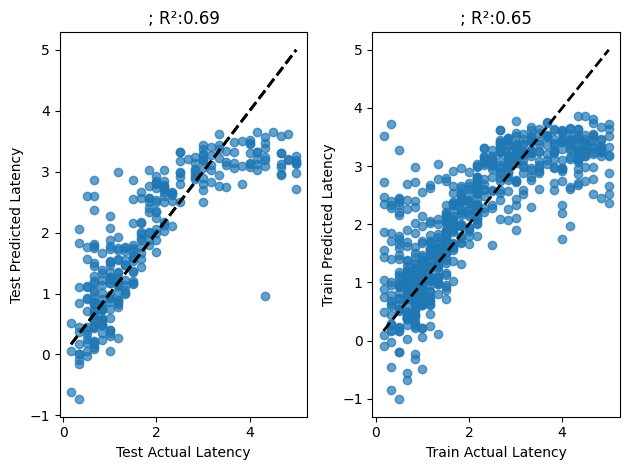

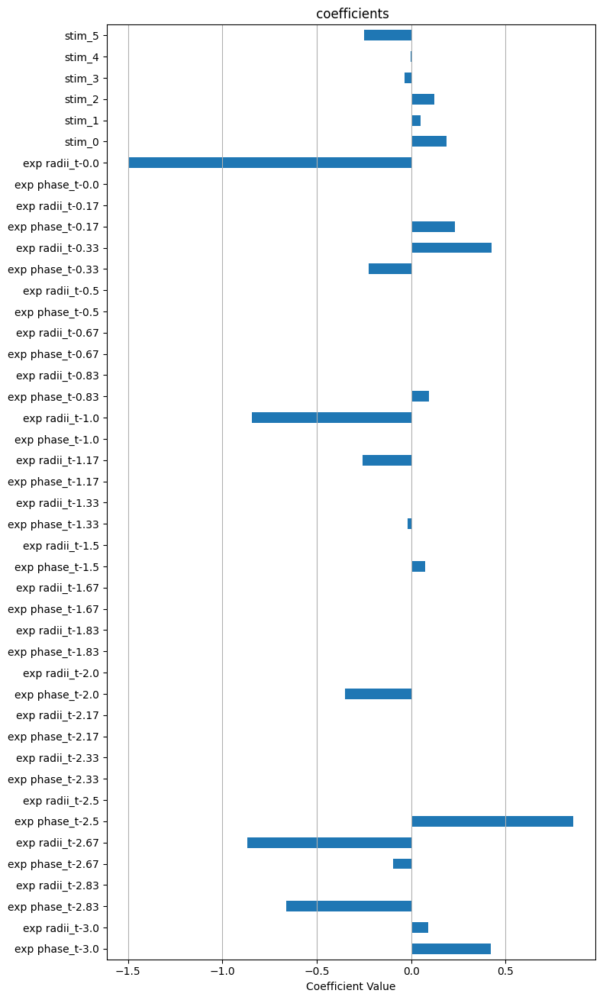

In [ ]:

'''####get rev latency; all stim ; exp  fps;  all  features'''
feature_list = [stim_exp_vel, stim_exp_acc, stim_exp_curve]
feature_labels = ["stim exp vel", "stim exp accel", "stim exp curv"]
# rev_bin = stim_exp_rev
data_prep_fnc = prep_data_latency
model_fit_fnc = fit_eval_lasso
result_visualization_fnc = visualize_model_regression
data_onsets = exp_onsets
score_label="r2"
score_fnc = r2_score
title_label = f"{neuron}; Reversal latency;\n all features exp fps; Mean ± STD balanced accuracy"
fps = 6
feature_to_best_models  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = exp_timesteps, 
                                                    check_warnings = True
                                                    )



'''####get rev latency; all stim ; exp  fps;   single features'''
title_label = f"{neuron}; Reversal latency;\n single features exp fps; Mean ± STD balanced accuracy"
feature_to_best_models  = get_plot_multi_stim_model_single_feature(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = exp_timesteps, 
                                                    check_warnings = True
                                                    )
'''####get rev latency; all stim ; resampled fps phase;  '''

n_tracks = stim_resampled_rev.shape[0]
phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
feature_list = [phase_resampled, radii_resampled]
feature_labels = ["resamp phase", "resampe radii"]
data_prep_fnc = prep_data_latency
model_fit_fnc = fit_eval_lasso
result_visualization_fnc = visualize_model_regression
score_fnc = r2_score
data_onsets = resampled_onsets
score_label="r2"
title_label = f"{neuron}; Reversal latency;\n phase resamppled; Mean ± STD balanced accuracy"
fps = 1.6
feature_to_best_models  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps, 
                                                    check_warnings = True
                                                    )




'''####get rev latency; all stim ; exp phase;  '''

####get rev prob; exp phase  resampled  all beh feature s
exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
exp_rad_high_fps = resample_2d(radii_resampled, target_fps=6, original_fps=1.6)
feature_list = [exp_phase_high_fps, exp_rad_high_fps]
feature_labels = ["exp phase", "exp radii"]

data_prep_fnc = prep_data_latency
model_fit_fnc = fit_eval_lasso
result_visualization_fnc = visualize_model_regression
data_onsets = exp_onsets
score_label="r2"
score_fnc = r2_score
title_label = f"{neuron}; Reversal latency;\n all features exp fps; Mean ± STD balanced accuracy"
fps = 6
feature_to_best_models  = get_plot_multi_stim_model(
                                                    data_prep_fnc,
                                                    model_fit_fnc, 
                                                    result_visualization_fnc, 
                                                    feature_list, 
                                                    feature_labels,
                                                    z, 
                                                    data_onsets,
                                                    exp_onsets, 
                                                    stim_exp_rev, 
                                                    durations,
                                                    fps,
                                                    # title_label,
                                                    score_fnc, 
                                                    test_size = 0.3, 
                                                    n_splits = 10, 
                                                    lstm_lag = 0, 
                                                    score_label=score_label, 
                                                    visualize_individ_stim = False, 

                                                    all_timesteps = resampled_timesteps, 
                                                    check_warnings = True
                                                    )



In [ ]:
# ####get rev prob; resampled  all beh feature s
# feature_list = [resampled_vel, resampled_acc, resampled_curve]
# feature_labels = ["vel", "accel", "curv"]
# data_prep_fnc = prep_data_rev_prob
# model_fit_fnc = fit_eval_linearSVC
# result_visualization_fnc = visualize_model_classification
# data_onsets = resampled_onsets
# title_label = f"{neuron}; Reversal prediction;\n resampled; all beh features; Mean ± STD balanced accuracy"
# fps = 1.6
# train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )
   

In [ ]:
# ####get rev prob; resampled  single feature 
# feature_list = [resampled_vel, resampled_acc, resampled_curve]
# feature_labels = ["vel", "accel", "curv"]
# data_prep_fnc = prep_data_rev_prob
# model_fit_fnc = fit_eval_linearSVC
# result_visualization_fnc = visualize_model_classification
# data_onsets = resampled_onsets
# title_label = f"{neuron}; Reversal prediction;\n resampled; single beh features; Mean ± STD balanced accuracy"
# fps = 1.6
# train_model_single_feature(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0
#                            )


In [ ]:
# ########
# ####get rev latency; exp  all beh features exp fps 
# feature_list = [exp_vel, exp_acc, exp_curve]
# feature_labels = ["vel", "accel", "curv"]

# data_prep_fnc = prep_data_rev_prob
# model_fit_fnc = fit_eval_linearSVC
# result_visualization_fnc = visualize_model_classification
# data_onsets = exp_onsets
# title_label = f"{neuron}; Reversal prob;\n all features exp fps; Mean ± STD balanced accuracy"
# fps = 6
# train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )



In [ ]:

# ####get rev latency; exp  single beh features exp fps 
# feature_list = [exp_vel, exp_acc, exp_curve]
# feature_labels = ["vel", "accel", "curv"]

# data_prep_fnc = prep_data_rev_prob
# model_fit_fnc = fit_eval_linearSVC
# result_visualization_fnc = visualize_model_classification
# data_onsets = exp_onsets
# title_label = f"{neuron}; Reversal prob;\n  single features exp fps; Mean ± STD balanced accuracy"
# fps = 6
# train_model_single_feature(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )



In [ ]:
# ####get rev prob; resampled  phase 

# n_tracks = resampled_rev.shape[0]
# phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
# radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
# feature_list = [phase_resampled, radii_resampled]
# feature_labels = ["phase", "radii"]
# data_prep_fnc = prep_data_rev_prob
# model_fit_fnc = fit_eval_linearSVC
# result_visualization_fnc = visualize_model_classification
# data_onsets = resampled_onsets
# title_label = f"{neuron}; Reversal prediction; phase and radii resampled\n Mean ± STD balanced accuracy"
# fps = 1.6

# train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )


In [ ]:
# ####get rev prob; exp phase  resampled  all beh feature s
# exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
# exp_rad_high_fps = resample_2d(radii_resampled, target_fps=6, original_fps=1.6)
# feature_list = [exp_phase_high_fps, exp_rad_high_fps]
# feature_labels = ["phase", "radii"]

# data_prep_fnc = prep_data_rev_prob
# model_fit_fnc = fit_eval_linearSVC
# result_visualization_fnc = visualize_model_classification
# data_onsets = exp_onsets
# title_label = f"{neuron}; Reversal prob;\n phase and radiii exp fps; Mean ± STD balanced accuracy"
# fps = 6
# lstm_lag = 0

# train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = lstm_lag, 
#                                single_feature = False, 
#                             )


   

In [ ]:

# import warnings
# from sklearn import metrics


# ####get rev latency; resampled  all beh feature s
# feature_list = [resampled_vel, resampled_acc, resampled_curve]
# feature_labels = ["vel", "accel", "curv"]
# data_prep_fnc = prep_data_latency
# model_fit_fnc = fit_eval_lasso
# result_visualization_fnc = visualize_model_regression
# data_onsets = resampled_onsets
# title_label = f"{neuron}; Reversal latency;\n all features resamppled; Mean ± STD balanced accuracy"
# fps = 1.6
# train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )

# ####get rev prob; resampled  single feature 
# feature_list = [resampled_vel, resampled_acc, resampled_curve]
# feature_labels = ["vel", "accel", "curv"]
# data_prep_fnc = prep_data_latency
# model_fit_fnc = fit_eval_lasso
# result_visualization_fnc = visualize_model_regression
# data_onsets = resampled_onsets
# title_label = f"{neuron}; Reversal latency;\n single features resampled;  Mean ± STD balanced accuracy"
# fps = 1.6
# train_model_single_feature(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0
#                            )

# ########
# ####get rev latency; exp  all beh features exp fps 
# feature_list = [exp_vel, exp_acc, exp_curve]
# feature_labels = ["vel", "accel", "curv"]
# data_prep_fnc = prep_data_latency
# model_fit_fnc = fit_eval_lasso
# result_visualization_fnc = visualize_model_regression
# data_onsets = exp_onsets
# title_label = f"{neuron}; Reversal latency;\n all features exp fps; Mean ± STD balanced accuracy"
# fps = 6
# train_model_feature_list(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )


# ####get rev latency; exp  single beh features exp fps 
# feature_list = [exp_vel, exp_acc, exp_curve]
# feature_labels = ["vel", "accel", "curv"]
# data_prep_fnc = prep_data_latency
# model_fit_fnc = fit_eval_lasso
# result_visualization_fnc = visualize_model_regression
# data_onsets = exp_onsets
# title_label = f"{neuron}; Reversal latency;\n  single feature exp fps; Mean ± STD balanced accuracy"
# fps = 6
# train_model_single_feature(data_prep_fnc,
#                                model_fit_fnc, 
#                                result_visualization_fnc, 
#                                feature_list, 
#                                feature_labels,
#                                z, 
#                                data_onsets,
#                                exp_onsets, 
#                                exp_rev, 
#                                durations,
#                                fps,
#                                title_label,
#                                test_size = 0.3, 
#                                n_splits = 10, 
#                                lstm_lag = 0, 
#                                single_feature = False, 
#                               #  rev_bin = resampled_rev
#                             )



# #########
# ####get rev prob; resampled  phase 
# n_tracks = resampled_rev.shape[0]
# phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
# radii_resampled =  feature_all_to_resampled(inferred_rad_all, n_tracks)
# feature_list = [phase_resampled, radii_resampled]
# feature_labels = ["phase", "radii"]
# data_prep_fnc = prep_data_latency
# model_fit_fnc = fit_eval_lasso
# result_visualization_fnc = visualize_model_regression
# data_onsets = resampled_onsets
# title_label = f"{neuron}; Reversal latency; phase and radii resampled; Mean ± STD balanced accuracy"
# fps = 1.6

# with warnings.catch_warnings():
#   train_model_feature_list(data_prep_fnc,
#                                 model_fit_fnc, 
#                                 result_visualization_fnc, 
#                                 feature_list, 
#                                 feature_labels,
#                                 z, 
#                                 data_onsets,
#                                 exp_onsets, 
#                                 exp_rev, 
#                                 durations,
#                                 fps,
#                                 title_label,
#                                 test_size = 0.3, 
#                                 n_splits = 10, 
#                                 lstm_lag = 0, 
#                                 single_feature = False, 
#                                 #  rev_bin = resampled_rev
#                               )

# ####get rev latency; exp phase 
# exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
# exp_rad_high_fps = resample_2d(radii_resampled, target_fps=6, original_fps=1.6)
# feature_list = [exp_phase_high_fps, exp_rad_high_fps]
# feature_labels = ["phase", "radii"]

# data_prep_fnc = prep_data_latency
# model_fit_fnc = fit_eval_lasso
# result_visualization_fnc = visualize_model_regression
# data_onsets = exp_onsets
# title_label = f"{neuron}; Reversal latency; phase and radii\n Mean ± STD balanced accuracy"
# fps = 6
# lstm_lag = 0


# with warnings.catch_warnings():
#   train_model_feature_list(data_prep_fnc,
#                                 model_fit_fnc, 
#                                 result_visualization_fnc, 
#                                 feature_list, 
#                                 feature_labels,
#                                 z, 
#                                 data_onsets,
#                                 exp_onsets, 
#                                 exp_rev, 
#                                 durations,
#                                 fps,
#                                 title_label,
#                                 test_size = 0.3, 
#                                 n_splits = 10, 
#                                 lstm_lag = lstm_lag, 
#                                 single_feature = False, 
#                               )




In [ ]:
#####run on all stim combined 

In [ ]:


# with warnings.catch_warnings():
        
#     # ##get inputs into lstm 
#     # beh_map = [z_norm.min(), z_norm.min()/2 + z_norm.max()/2, z_norm.max()]

#     warnings.simplefilter("ignore")
    
#     for feature, exp_feature, feature_lbl in zip([resampled_vel, resampled_acc, resampled_curve],
#                                                  [exp_vel, exp_acc, exp_curve], 
#                                                  ["vel", "accel", "curv"]):
#         print("feature_lbl", feature_lbl)
#         include_beh = False
#         n_tracks = resampled_rev.shape[0]
#         n_splits = 10
#         results_dict = {}  # Store mean/std r² per i and n_timesteps
#         best_models = {}   # Store best model per (i, n_timesteps)
#         lstm_lag = 0
#         idxs = [[0],[1],[2],[3],[4],[5]]
#         fig, ax = plt.subplots()
#         for i, (resampled_onset, exp_onset) in enumerate(zip(resampled_onsets, exp_onsets)):
#             score_means = []
#             score_stds = []
#             # all_r2_means = []
#             all_scores_per_i = {}
#             n_timesteps_list = []
#             onset = resampled_onset-1
#             n_timesteps = 1
#             # for n_timesteps in range(1, 15, 3):
#             # for n_timesteps in range(1, 15, 1):
#             print(f"\nProcessing i={i}, n_timesteps={n_timesteps}")

#             # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps,   lstm_lag = lstm_lag)#shape (n_tracks, n_frames, n_features)
#             # X_stim_all, feature_names_all = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
#             # X_stim_all1, _ = prep_FB_inputs_features_only(resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn, onset, n_timesteps, z,  lstm_lag = lstm_lag, include_beh = include_beh)#shape (n_tracks, n_frames, n_features)
#             features_list = [feature]
#             feature_labels = [feature_lbl]
#             X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
#                 # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
#                 features_list, feature_labels, onset,  n_timesteps, z, lstm_lag = lstm_lag, 
            
#                             )
            
#             # X_stim_features = X_all_LSTM[:, stim_onset, :]

            
#             Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
#             no_rev_at_onset = Y_latency!=0
#             Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
#             X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
#             Y_latency1 = Y_latency[no_rev_at_onset]
#             print(feature_names_all)
#             fig, ax = plt.subplots()
#             ax.scatter(X_prob.flatten(), Y_latency1, color = "blue", alpha = 0.3)
            
            
            
            
#             features_list = [exp_feature]
#             feature_labels = [feature_lbl]
#             X_stim_all, feature_names_all = prep_FB_inputs_select_features_only(
#                 # resampled_vel, resampled_acc, resampled_curve, resampled_rev, resampled_turn,
#                 features_list, feature_labels, exp_onset-1,  n_timesteps, z, lstm_lag = lstm_lag, 
            
#                             )
            
                        
#             Y_latency = latency_to_reversal(exp_rev, exp_onset, max_latency = 6*durations[i]+1)/6 # nan where not 
#             no_rev_at_onset = Y_latency!=0
#             Y_prob = np.logical_not(np.isnan(Y_latency[no_rev_at_onset]))# classfy y/n did rev happen
#             X_prob = copy.deepcopy(X_stim_all[no_rev_at_onset])
#             Y_latency1 = Y_latency[no_rev_at_onset]
#             print(feature_names_all)
#             # fig, ax = plt.subplots()
            
#             ax.scatter(X_prob.flatten(), Y_latency1, color = "orange", alpha = 0.3)
            
            
            
#             ax.set_title(f"stim: {i}; {feature_lbl}")
#             ax.set_xlabel(f"{feature_lbl}")
#             ax.set_ylabel(f"latency")
            
#         ##plot smoothed phase vss curvature 



NameError: name 'exp_vel' is not defined

In [ ]:
#############
#####check if can infer phase from interpatlated tim ebetwen revs 
##########

import numpy as np
def event_interpolation_fraction(events):
    """
    Input: 1D np.array with 1 where event occurs, 0 elsewhere.
    Output: 
      - -1 at event indices
      - linearly interpolated fraction of time to next event for other positions
    """
    events = np.asarray(events)
    result = np.full_like(events, np.nan, dtype=float)
    event_idxs = np.where(events == 1)[0]

    if len(event_idxs) == 0:
        return result  # no events, return NaNs

    # # Set -1 where events occur
    # result[event_idxs] = -1.0

    # Loop over event pairs to fill in between
    for i in range(len(event_idxs) - 1):
        start = event_idxs[i]
        end = event_idxs[i + 1]
        gap = end - start
        for j in range(1, gap):
            frac = j / gap  # fraction toward the next event
            result[start + j] = frac

    return result

def get_interpolated_time_since_last_reversal(rev_bin):
    n_frames, n_tracks = rev_bin.shape
    interpolated_fwd_time = np.zeros_like(rev_bin)
    for track in range(n_tracks):
        interpolated_fwd_time[:,track] = event_interpolation_fraction(rev_bin[:,track])
        
    return interpolated_fwd_time

# from 
from sklearn.linear_model import LogisticRegression, Lasso, LinearRegression
from sklearn.model_selection import GridSearchCV, train_test_split
######see if can predict phase from time_since_last_rev 
###need to get phase interpolated or somte 
random_state = 30
test_size = 0.3
interpolated_fwds = get_interpolated_time_since_last_reversal(exp_rev)
n_tracks, n_frames_exp = exp_rev.shape


phase_resampled = feature_all_to_resampled(inferred_phases_all, n_tracks)
exp_phase_high_fps = resample_2d(phase_resampled, target_fps=6, original_fps=1.6)
Y = exp_phase_high_fps.flatten()
X = interpolated_fwds.flatten()

non_nan_is = np.argwhere(np.logical_and(np.logical_not(np.isnan(X)), np.logical_not(np.isnan(Y)))).flatten()
X = X[non_nan_is]
X = X.reshape(-1, 1)
Y = Y[non_nan_is]
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=test_size, random_state=random_state)


alphas = np.logspace(-4, 2, 20)
model_label= f"lasso"
# lasso = Lasso(max_iter=10000)
model = LinearRegression()
model.fit(X_train, y_train)
# grid_search = GridSearchCV(model, {'alpha': alphas}, cv=5, scoring='r2')
# grid_search.fit(X_train, y_train)

# best_model = grid_search.best_estimator_
# y_pred = best_model.predict(X_test)
# r2 = r2_score(y_test, y_pred)
# model = LinearRegression()

n_timesteps = 1
fit_visualize_model_regression(model, model_label, np.array(["interpol"]), X_train, X_test, y_train, y_test, n_timesteps, feature_names_ordered =  np.array(["interpol"]))



In [ ]:
########compare latnecy prediciton feautres single feature  exp fps

In [ ]:
########compare latnecy prediciton time delayed pahse exp fps


In [ ]:
#####fix so doing all with the same model across stim 